<a href="https://colab.research.google.com/github/deepshikharbhardwaj/Camera-Calibration/blob/main/CV_A2_Q1_and_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Computer Vision Assignment 2**

---

**Name : Deepshikhar Bhardwaj**

**Roll Number : M20MA004**

**M.Tech - DCS**

# **0. Importing Essesntial Libraries**

In [ ]:
# import the necessary packages
from imutils import paths
import numpy as np
import argparse
import imutils
import cv2
from google.colab.patches import cv2_imshow

# **1. Panorama**

In [ ]:
imgg1=cv2.resize(cv2.imread("1.jpeg",-1),(500,300))
imgg2=cv2.resize(cv2.imread("2.jpeg",-1),(500,300))
imgg3=cv2.resize(cv2.imread("3.jpeg",-1),(500,300))
imgg4=cv2.resize(cv2.imread("4.jpeg",-1),(500,300))
imgg5=cv2.resize(cv2.imread("5.jpeg",-1),(500,300))

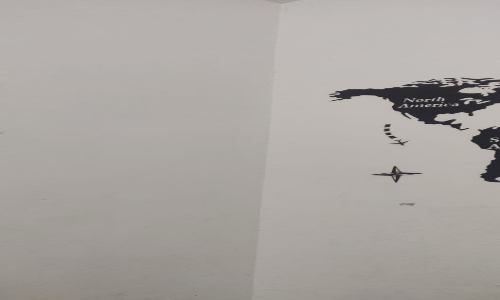

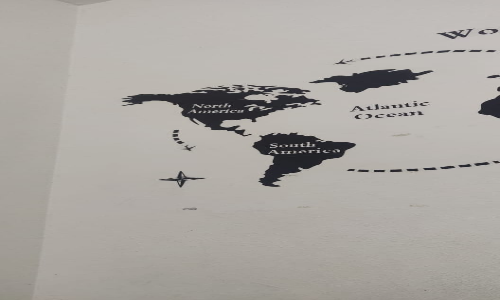

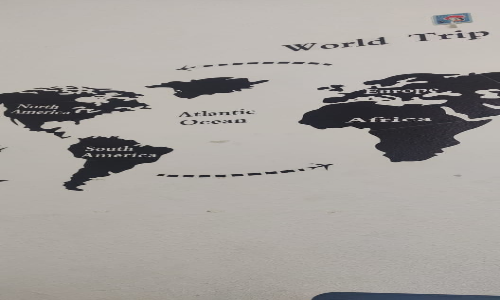

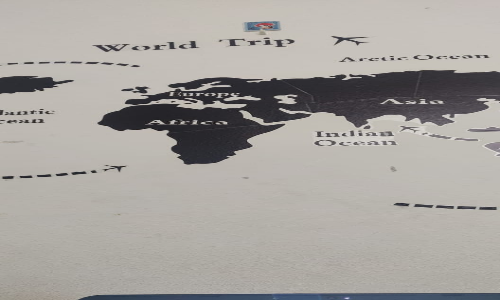

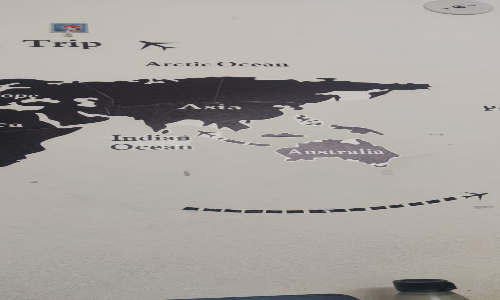

In [ ]:
images=[]

images.append(imgg1)
images.append(imgg2)
images.append(imgg3)
images.append(imgg4)
images.append(imgg5)

for i in images:
  cv2_imshow(i)

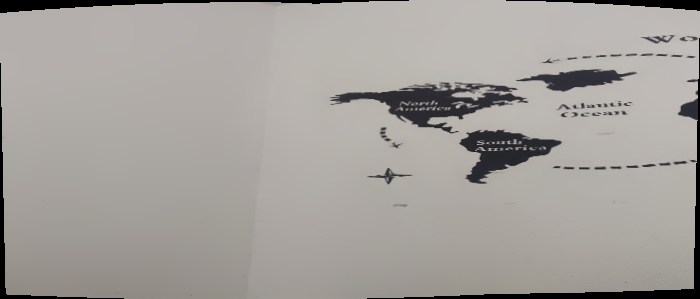

In [ ]:
stitcher=cv2.Stitcher.create(cv2.Stitcher_PANORAMA)

images1 = []
images1.append(images[0])
images1.append(images[1])
(status1,result1)=stitcher.stitch(images1)
cv2_imshow(result1)

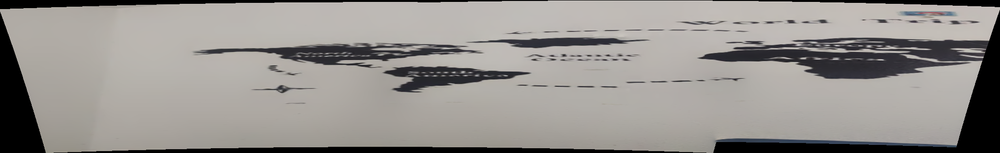

In [ ]:
stitcher=cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
stitcher.setPanoConfidenceThresh(0.3) # might be too aggressive for real examples

images2 = []
images2.append(images[1])
images2.append(images[2])
(status2,result2)=stitcher.stitch(images2)
cv2_imshow(result2)


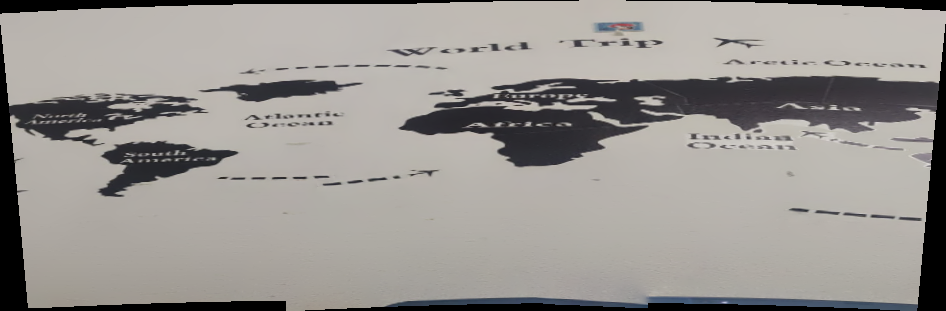

In [ ]:
stitcher=cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
stitcher.setPanoConfidenceThresh(0) # might be too aggressive for real examples

images3 = []
images3.append(images[2])
images3.append(images[3])
(status3,result3)=stitcher.stitch(images3)
cv2_imshow(result3)

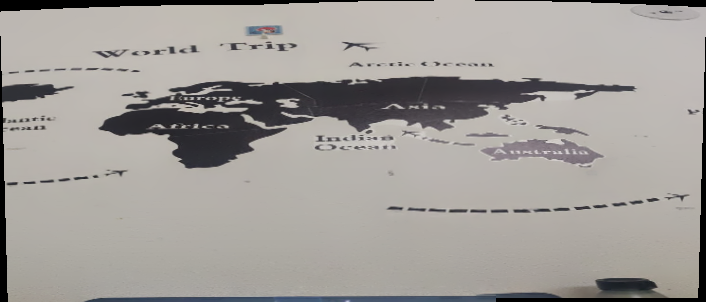

Panaroma gen


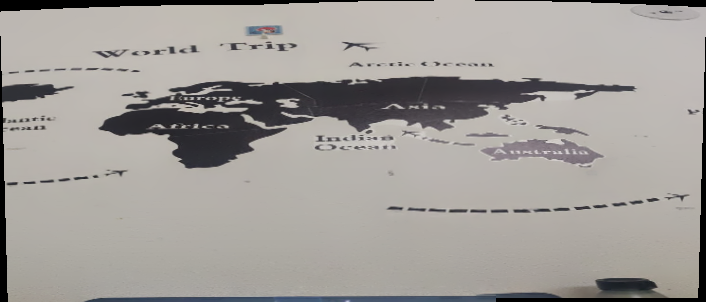

(302, 706, 3)


In [ ]:

stitcher=cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
stitcher.setPanoConfidenceThresh(0.5) # might be too aggressive for real examples

images4 = []
images4.append(images[3])
images4.append(images[4])
(status4,result4)=stitcher.stitch(images4)
cv2_imshow(result4)
if(status4==cv2.STITCHER_OK):
  cv2_imshow(result4)
  print(result4.shape)
  

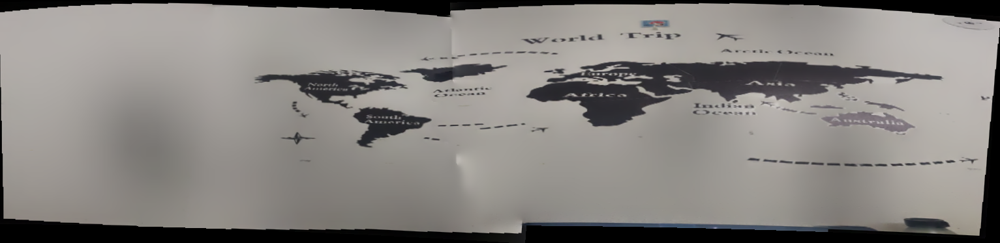

Panaroma gen


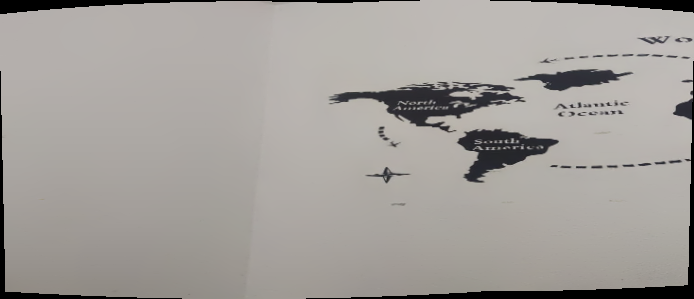

(299, 694, 3)


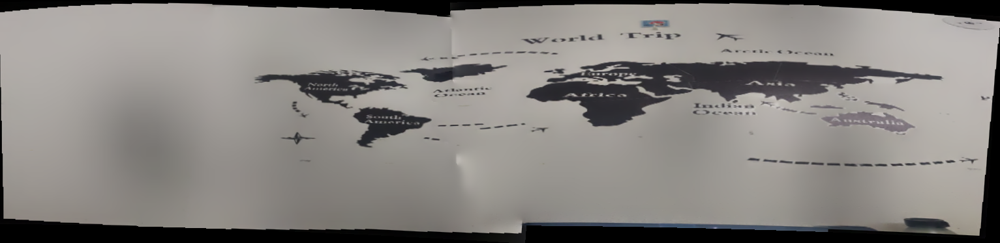

In [ ]:

stitcher=cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
stitcher.setPanoConfidenceThresh(0.5) 
results_combined = []
results_combined.append(result1)
results_combined.append(result2)
results_combined.append(result3)
results_combined.append(result4)
images4 = []
result11=cv2.resize(result1,(500,300))
result12=cv2.resize(result2,(500,300))
result13=cv2.resize(result3,(500,300))
result14=cv2.resize(result4,(500,300))
images4.append(images[3])
images4.append(images[4])

(status4,result4)=stitcher.stitch(results_combined)
cv2_imshow(result4)
if(status4==cv2.STITCHER_OK):
  cv2_imshow(result1)
  print(result1.shape)

results_combined_formatted = []
results_combined_formatted.append(result11)
results_combined_formatted.append(result12)
results_combined_formatted.append(result13)
results_combined_formatted.append(result14)

(status5,result5)=stitcher.stitch(results_combined_formatted)
cv2_imshow(result4)
if(status5==cv2.STITCHER_OK):
  cv2_imshow(result5)
  print(result5.shape)

Alpha Blending on last column of Image 1 and first column of image 2

The image stitching method is capable of producing more aesthetically pleasing output panorama images through the use of gain compensation and **image blending**.
Reference : https://www.pyimagesearch.com/2018/12/17/image-stitching-with-opencv-and-python/



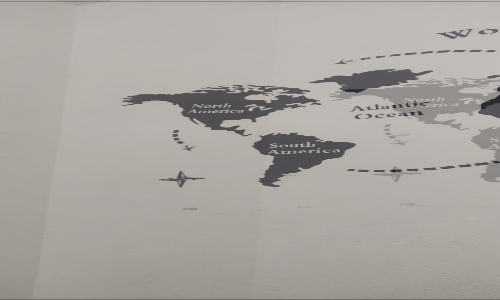

In [ ]:
imgg1[:][-1] = imgg1[:][-1]*0.3
imgg2[:][1] = imgg2[:][0]*0.7
img = cv2.addWeighted(imgg1, 0.3, imgg2, 0.7,-1)
cv2_imshow(img)

# **2. Harris Corner Detection (in built)**

In [ ]:
def inbuilt_harris(img):
    #gray = cv2.imread('1.jpg',0)
    global th
#cv2_imshow(gray)
#gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    gray = np.float32(img)
    dst = cv2.cornerHarris(gray, 2, 3, 0.04) #image, windowsize, ksize, 'k' hariss parameter

    dst = cv2.dilate(dst, None)

    gray[dst > 0.01 * dst.max()] = [255]
    num_corners = np.sum(dst > 0.01 * dst.max())
    th = dst.max()
    cv2_imshow(gray)
    print('Number of Corners detected : ', num_corners)
    print(th)
    return gray

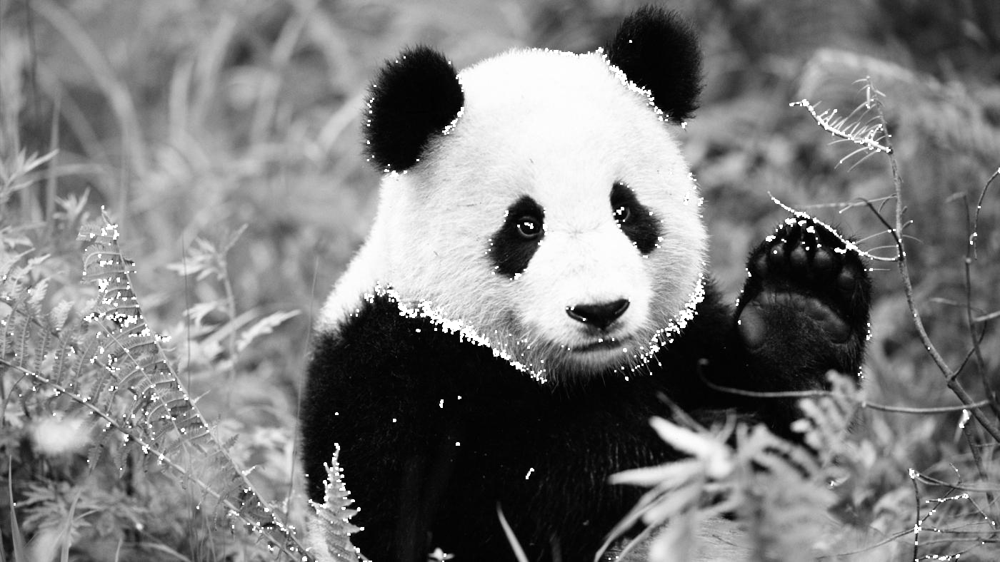

Number of Corners detected :  16564
83013710.0


array([[114., 126., 128., ...,  50.,  49.,  48.],
       [116., 128., 129., ...,  53.,  52.,  52.],
       [119., 130., 129., ...,  55.,  55.,  55.],
       ...,
       [123., 121., 107., ..., 132., 138., 139.],
       [120., 122., 110., ..., 131., 137., 138.],
       [118., 122., 113., ..., 130., 135., 135.]], dtype=float32)

In [ ]:
gray = cv2.imread('1.jpg',0)
inbuilt_harris(gray)

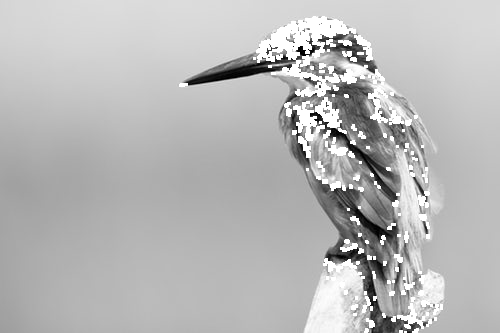

Number of Corners detected :  8452
41408350.0


array([[212., 213., 213., ..., 217., 217., 217.],
       [212., 213., 213., ..., 217., 217., 217.],
       [212., 213., 213., ..., 217., 217., 217.],
       ...,
       [158., 158., 158., ..., 182., 182., 183.],
       [158., 158., 158., ..., 182., 182., 183.],
       [158., 158., 158., ..., 182., 182., 183.]], dtype=float32)

In [ ]:
gray = cv2.imread('2.jpg',0)
inbuilt_harris(gray)

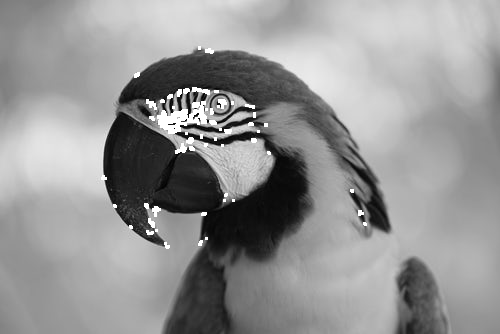

Number of Corners detected :  2093
48073616.0


array([[123., 124., 124., ..., 184., 182., 181.],
       [124., 124., 124., ..., 184., 183., 182.],
       [124., 124., 125., ..., 185., 184., 182.],
       ...,
       [131., 132., 132., ..., 140., 140., 139.],
       [131., 132., 132., ..., 139., 139., 139.],
       [131., 132., 132., ..., 140., 139., 139.]], dtype=float32)

In [ ]:
gray = cv2.imread('3.jpg',0)
inbuilt_harris(gray)

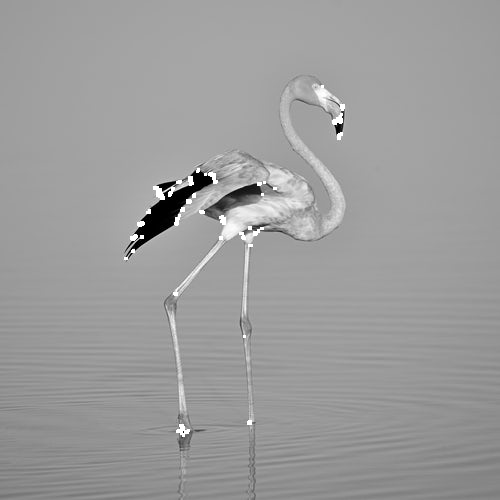

Number of Corners detected :  1120
129765280.0


array([[154., 154., 154., ..., 152., 152., 152.],
       [154., 154., 154., ..., 153., 153., 153.],
       [154., 154., 154., ..., 153., 153., 153.],
       ...,
       [120., 121., 121., ..., 132., 132., 132.],
       [128., 128., 129., ..., 134., 134., 134.],
       [134., 135., 135., ..., 135., 135., 135.]], dtype=float32)

In [ ]:
gray = cv2.imread('4.jpg',0)
inbuilt_harris(gray)


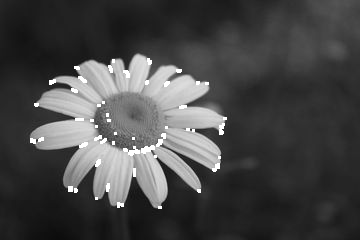

Number of Corners detected :  1218
19312298.0


array([[38., 38., 37., ..., 73., 73., 73.],
       [38., 38., 37., ..., 73., 72., 73.],
       [38., 37., 37., ..., 72., 72., 72.],
       ...,
       [28., 28., 28., ..., 26., 26., 26.],
       [28., 28., 28., ..., 26., 25., 25.],
       [28., 28., 27., ..., 25., 25., 25.]], dtype=float32)

In [ ]:
gray = cv2.imread('5.jpg',0)
inbuilt_harris(gray)

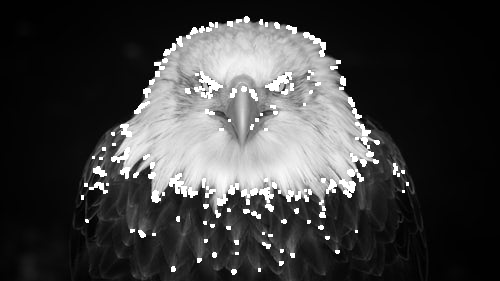

Number of Corners detected :  5618
33503594.0


array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [3., 3., 3., ..., 1., 1., 1.],
       [3., 3., 3., ..., 1., 1., 1.],
       [3., 3., 3., ..., 1., 1., 1.]], dtype=float32)

In [ ]:
gray = cv2.imread('6.jpg',0)
inbuilt_harris(gray)

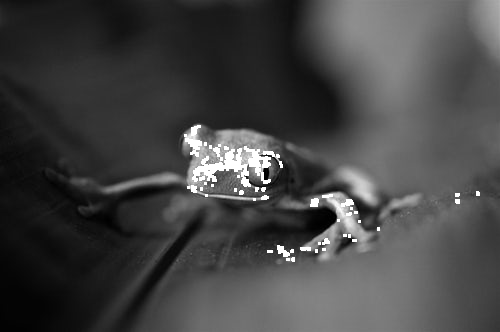

Number of Corners detected :  2482
9803336.0


array([[ 21.,  21.,  20., ..., 167., 170., 175.],
       [ 22.,  22.,  21., ..., 165., 168., 173.],
       [ 24.,  23.,  23., ..., 166., 169., 173.],
       ...,
       [  2.,   2.,   2., ...,  54.,  53.,  54.],
       [  2.,   2.,   2., ...,  54.,  54.,  54.],
       [  2.,   2.,   2., ...,  55.,  54.,  55.]], dtype=float32)

In [ ]:
gray = cv2.imread('7.jpg',0)
inbuilt_harris(gray)

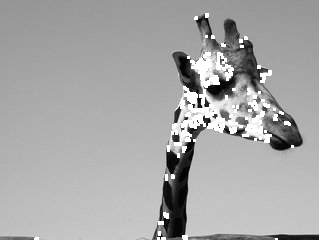

Number of Corners detected :  2840
107388870.0


array([[149., 149., 149., ..., 150., 150., 150.],
       [149., 149., 149., ..., 150., 150., 150.],
       [149., 149., 149., ..., 150., 150., 150.],
       ...,
       [123., 123., 120., ...,  21.,  21.,  20.],
       [132., 130., 126., ...,  23.,  23.,  23.],
       [121., 120., 119., ...,  22.,  22.,  21.]], dtype=float32)

In [ ]:
gray = cv2.imread('8.jpg',0)
inbuilt_harris(gray)

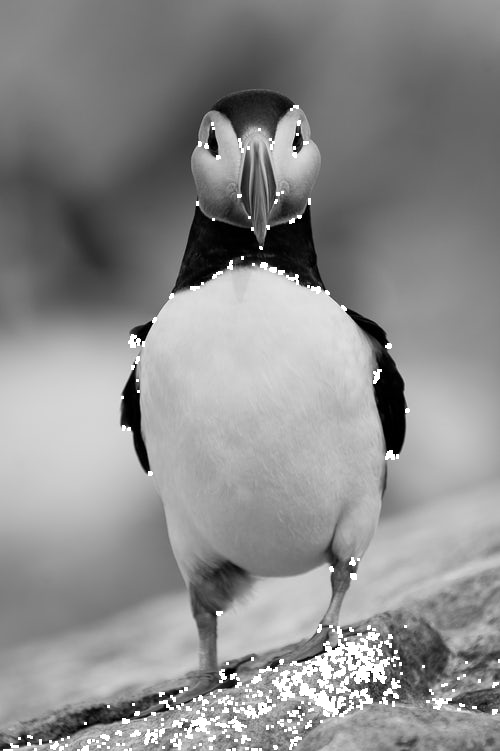

Number of Corners detected :  9816
29200912.0


array([[132., 132., 132., ..., 153., 153., 153.],
       [132., 132., 132., ..., 152., 152., 152.],
       [132., 132., 132., ..., 152., 152., 152.],
       ...,
       [ 36.,  33.,  32., ..., 114., 111., 111.],
       [ 34.,  34.,  36., ..., 108., 105., 105.],
       [ 70.,  76.,  84., ..., 108., 104., 105.]], dtype=float32)

In [ ]:
gray = cv2.imread('9.jpg',0)
inbuilt_harris(gray)

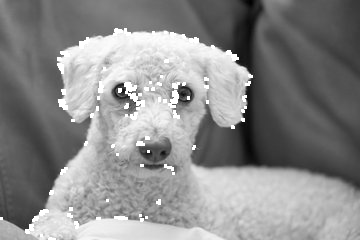

Number of Corners detected :  2138
22471114.0


array([[141., 138., 134., ...,  56.,  56.,  56.],
       [140., 137., 133., ...,  56.,  56.,  56.],
       [138., 136., 133., ...,  56.,  56.,  56.],
       ...,
       [165., 162., 160., ..., 169., 172., 173.],
       [167., 162., 159., ..., 172., 169., 166.],
       [168., 163., 159., ..., 170., 163., 158.]], dtype=float32)

In [ ]:
gray = cv2.imread('10.jpg',0)
inbuilt_harris(gray)

# **2.i Harris Corner Detection Scratch**
Theory Reference : https://www.youtube.com/watch?v=8aNOzgIbaeA&t=120s

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def find_harris_corners(input_img, k, window_size, threshold):
    
    corner_list = []
    output_img = cv2.cvtColor(input_img.copy(), cv2.COLOR_GRAY2RGB)
    #cv2_imshow(output_img)

    offset = int(window_size/2)
    height = input_img.shape[0] - offset  #height
    width = input_img.shape[1] - offset  #width
    
    
    dy, dx = np.gradient(input_img)  #gradients
    Ixx = dx**2
    Ixy = dy*dx
    Iyy = dy**2
    
    
    for y in range(offset, height):
        for x in range(offset, width):
            
            #Values of sliding window
            start_y = y - offset
            end_y = y + offset + 1
            start_x = x - offset
            end_x = x + offset + 1
            
            #The variable names are representative to the variable of the Harris corner equation
            windowIxx = Ixx[start_y : end_y, start_x : end_x]
            windowIxy = Ixy[start_y : end_y, start_x : end_x]
            windowIyy = Iyy[start_y : end_y, start_x : end_x]
            
            #Sum of squares of intensities of partial derivatives 
            Sxx = windowIxx.sum()
            Sxy = windowIxy.sum()
            Syy = windowIyy.sum()

            #Calculate determinant and trace of the matrix
            det = (Sxx * Syy) - (Sxy**2)
            trace = Sxx + Syy
            
            #Calculate r for Harris Corner equation
            r = det - k*(trace**2)

            if r > threshold:
                corner_list.append([x, y, r])
                output_img[y,x] = (255,255,255)
    
    return corner_list, output_img

Varying with same window size 3

In [ ]:
def scratch_harris(img):
    k = 0.04
    window_size = 3
    threshold = 0.01 * th #for CORNER DETECTION THIS VALUE SHOUD BE VERY HIGH AS PER HARRIS
    #img=cv2.imread("/content/1.jpg",0)
    corner_list, corner_img = find_harris_corners(img, k, window_size, threshold)
    cv2_imshow(corner_img)
    print('Number of Corners ',len(corner_list))
    return corner_img

83013710.0


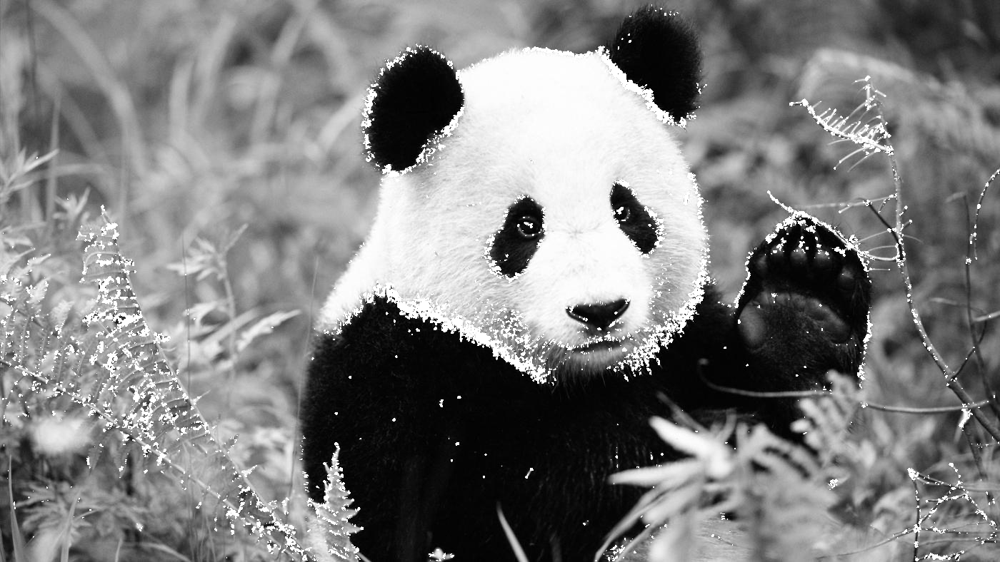

Number of Corners  39885


array([[[114, 114, 114],
        [126, 126, 126],
        [128, 128, 128],
        ...,
        [ 50,  50,  50],
        [ 49,  49,  49],
        [ 48,  48,  48]],

       [[116, 116, 116],
        [128, 128, 128],
        [129, 129, 129],
        ...,
        [ 53,  53,  53],
        [ 52,  52,  52],
        [ 52,  52,  52]],

       [[119, 119, 119],
        [130, 130, 130],
        [129, 129, 129],
        ...,
        [ 55,  55,  55],
        [ 55,  55,  55],
        [ 55,  55,  55]],

       ...,

       [[123, 123, 123],
        [121, 121, 121],
        [107, 107, 107],
        ...,
        [132, 132, 132],
        [138, 138, 138],
        [139, 139, 139]],

       [[120, 120, 120],
        [122, 122, 122],
        [110, 110, 110],
        ...,
        [131, 131, 131],
        [137, 137, 137],
        [138, 138, 138]],

       [[118, 118, 118],
        [122, 122, 122],
        [113, 113, 113],
        ...,
        [130, 130, 130],
        [135, 135, 135],
        [135, 135, 135]]

In [ ]:
print(th)
img=cv2.imread("/content/1.jpg",0)
scratch_harris(img)


**Vaying Window size 1**

In [ ]:
def scratch_harris(img):
    k = 0.04
    window_size = 1
    threshold = 0.01 * th #for CORNER DETECTION THIS VALUE SHOUD BE VERY HIGH AS PER HARRIS
    #img=cv2.imread("/content/1.jpg",0)
    corner_list, corner_img = find_harris_corners(img, k, window_size, threshold)
    cv2_imshow(corner_img)
    print('Number of Corners ',len(corner_list))
    return corner_img

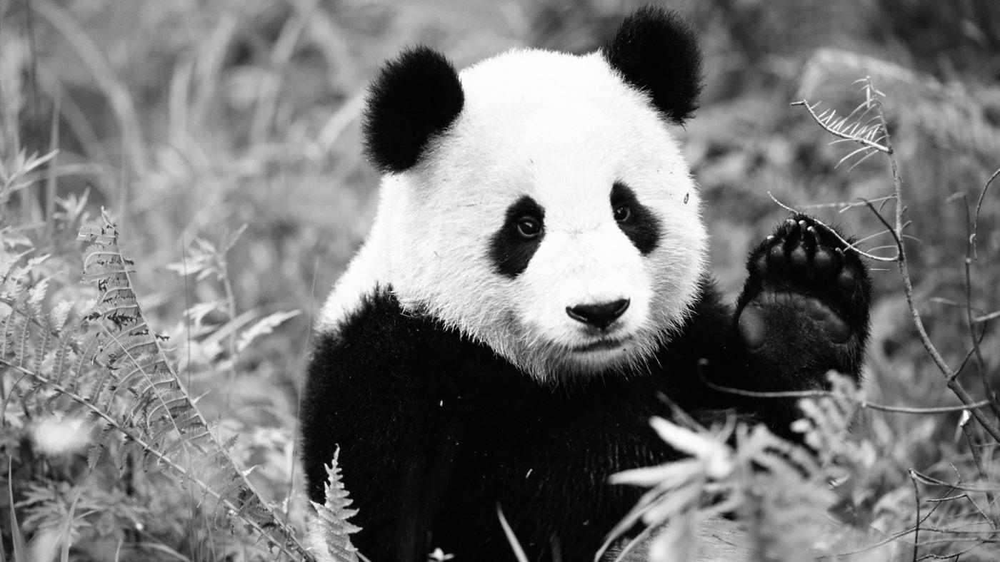

Number of Corners  0


array([[[114, 114, 114],
        [126, 126, 126],
        [128, 128, 128],
        ...,
        [ 50,  50,  50],
        [ 49,  49,  49],
        [ 48,  48,  48]],

       [[116, 116, 116],
        [128, 128, 128],
        [129, 129, 129],
        ...,
        [ 53,  53,  53],
        [ 52,  52,  52],
        [ 52,  52,  52]],

       [[119, 119, 119],
        [130, 130, 130],
        [129, 129, 129],
        ...,
        [ 55,  55,  55],
        [ 55,  55,  55],
        [ 55,  55,  55]],

       ...,

       [[123, 123, 123],
        [121, 121, 121],
        [107, 107, 107],
        ...,
        [132, 132, 132],
        [138, 138, 138],
        [139, 139, 139]],

       [[120, 120, 120],
        [122, 122, 122],
        [110, 110, 110],
        ...,
        [131, 131, 131],
        [137, 137, 137],
        [138, 138, 138]],

       [[118, 118, 118],
        [122, 122, 122],
        [113, 113, 113],
        ...,
        [130, 130, 130],
        [135, 135, 135],
        [135, 135, 135]]

In [ ]:
img=cv2.imread("/content/1.jpg",0)
scratch_harris(img)

Window Size 2

In [ ]:
def scratch_harris(img):
    k = 0.04
    window_size = 2
    threshold = 0.01 * th #for CORNER DETECTION THIS VALUE SHOUD BE VERY HIGH AS PER HARRIS
    #img=cv2.imread("/content/1.jpg",0)
    corner_list, corner_img = find_harris_corners(img, k, window_size, threshold)
    cv2_imshow(corner_img)
    print('Number of Corners ',len(corner_list))
    return corner_img

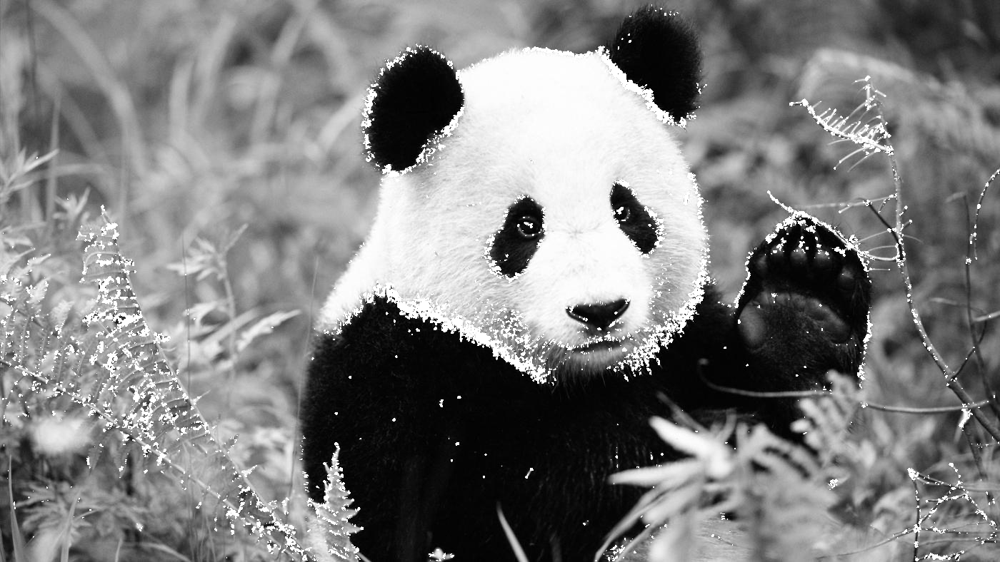

Number of Corners  39885


array([[[114, 114, 114],
        [126, 126, 126],
        [128, 128, 128],
        ...,
        [ 50,  50,  50],
        [ 49,  49,  49],
        [ 48,  48,  48]],

       [[116, 116, 116],
        [128, 128, 128],
        [129, 129, 129],
        ...,
        [ 53,  53,  53],
        [ 52,  52,  52],
        [ 52,  52,  52]],

       [[119, 119, 119],
        [130, 130, 130],
        [129, 129, 129],
        ...,
        [ 55,  55,  55],
        [ 55,  55,  55],
        [ 55,  55,  55]],

       ...,

       [[123, 123, 123],
        [121, 121, 121],
        [107, 107, 107],
        ...,
        [132, 132, 132],
        [138, 138, 138],
        [139, 139, 139]],

       [[120, 120, 120],
        [122, 122, 122],
        [110, 110, 110],
        ...,
        [131, 131, 131],
        [137, 137, 137],
        [138, 138, 138]],

       [[118, 118, 118],
        [122, 122, 122],
        [113, 113, 113],
        ...,
        [130, 130, 130],
        [135, 135, 135],
        [135, 135, 135]]

In [ ]:
img=cv2.imread("/content/1.jpg",0)
scratch_harris(img)

Window Size 10

In [ ]:
def scratch_harris(img):
    k = 0.04
    window_size = 10
    threshold = 0.01 * th #for CORNER DETECTION THIS VALUE SHOUD BE VERY HIGH AS PER HARRIS
    #img=cv2.imread("/content/1.jpg",0)
    corner_list, corner_img = find_harris_corners(img, k, window_size, threshold)
    cv2_imshow(corner_img)
    print('Number of Corners ',len(corner_list))
    return corner_img

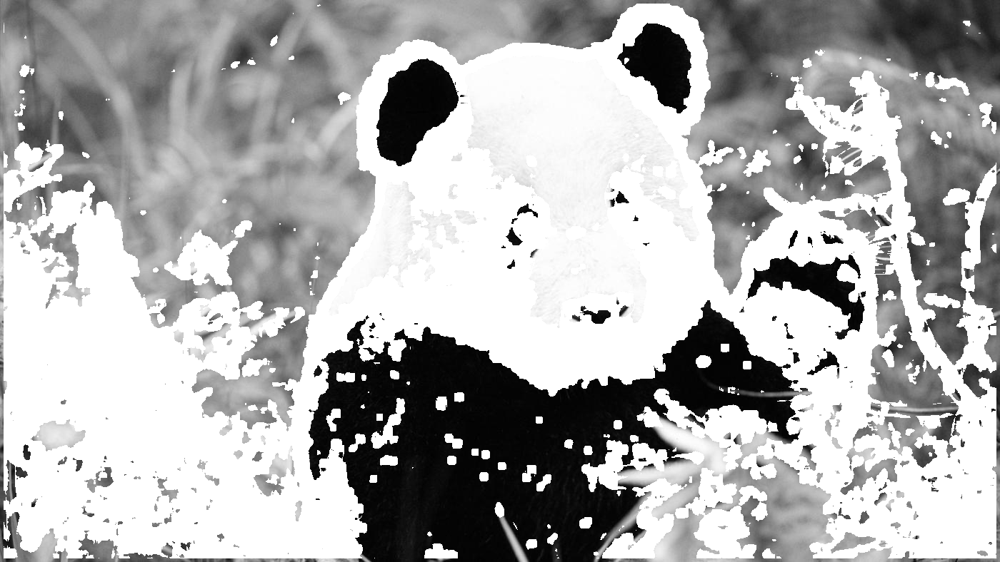

Number of Corners  454355


array([[[114, 114, 114],
        [126, 126, 126],
        [128, 128, 128],
        ...,
        [ 50,  50,  50],
        [ 49,  49,  49],
        [ 48,  48,  48]],

       [[116, 116, 116],
        [128, 128, 128],
        [129, 129, 129],
        ...,
        [ 53,  53,  53],
        [ 52,  52,  52],
        [ 52,  52,  52]],

       [[119, 119, 119],
        [130, 130, 130],
        [129, 129, 129],
        ...,
        [ 55,  55,  55],
        [ 55,  55,  55],
        [ 55,  55,  55]],

       ...,

       [[123, 123, 123],
        [121, 121, 121],
        [107, 107, 107],
        ...,
        [132, 132, 132],
        [138, 138, 138],
        [139, 139, 139]],

       [[120, 120, 120],
        [122, 122, 122],
        [110, 110, 110],
        ...,
        [131, 131, 131],
        [137, 137, 137],
        [138, 138, 138]],

       [[118, 118, 118],
        [122, 122, 122],
        [113, 113, 113],
        ...,
        [130, 130, 130],
        [135, 135, 135],
        [135, 135, 135]]

In [ ]:
img=cv2.imread("/content/1.jpg",0)
scratch_harris(img)

**Graph for Number of corners detected for various Window size and threshold**

Output Image for window size  1


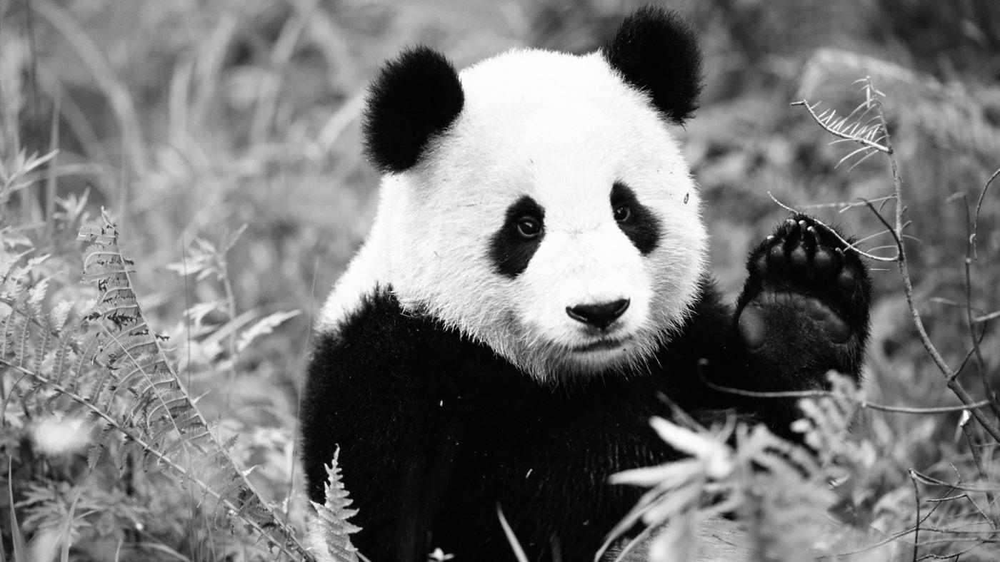

Number of Corners  0
Output Image for window size  2


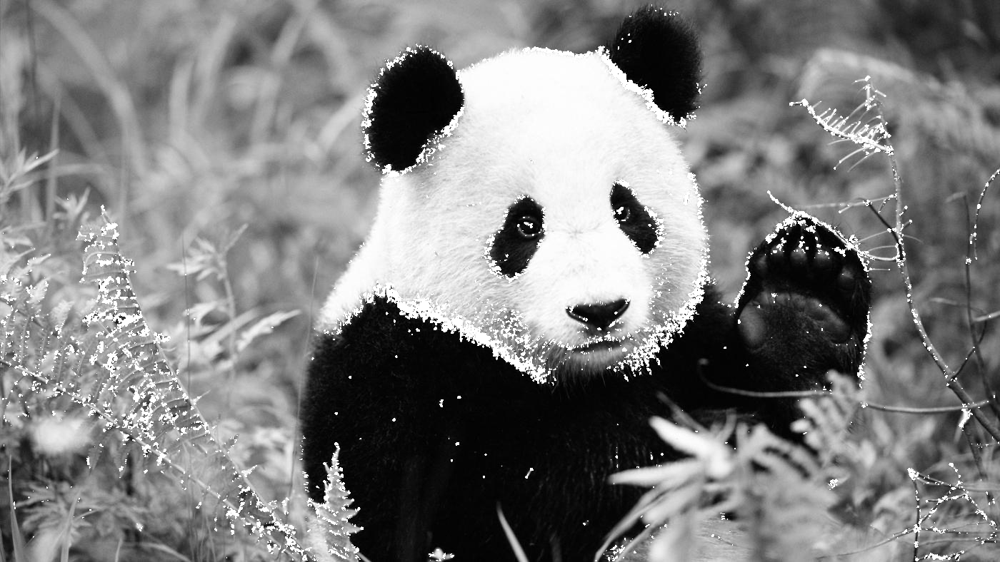

Number of Corners  39885
Output Image for window size  3


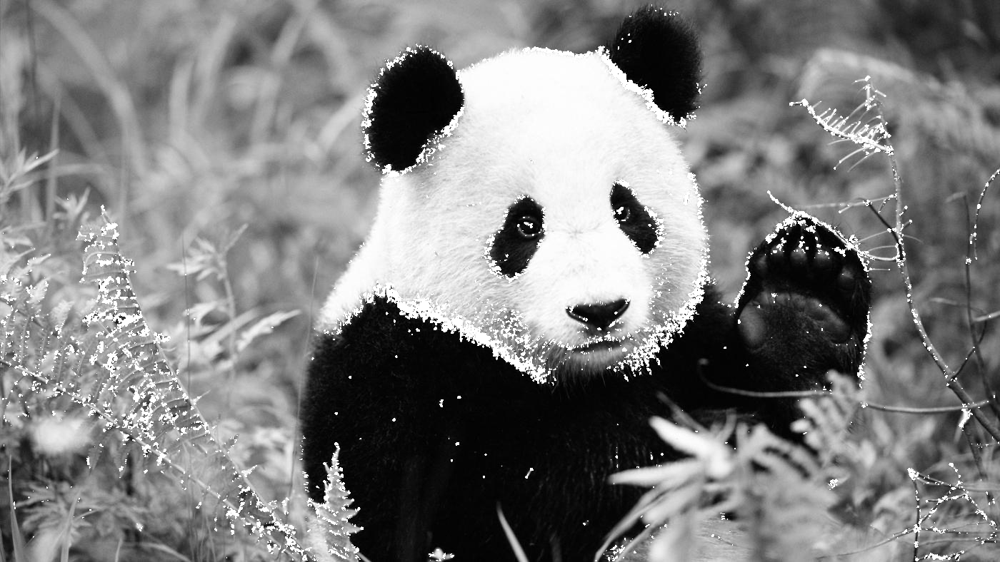

Number of Corners  39885
Output Image for window size  4


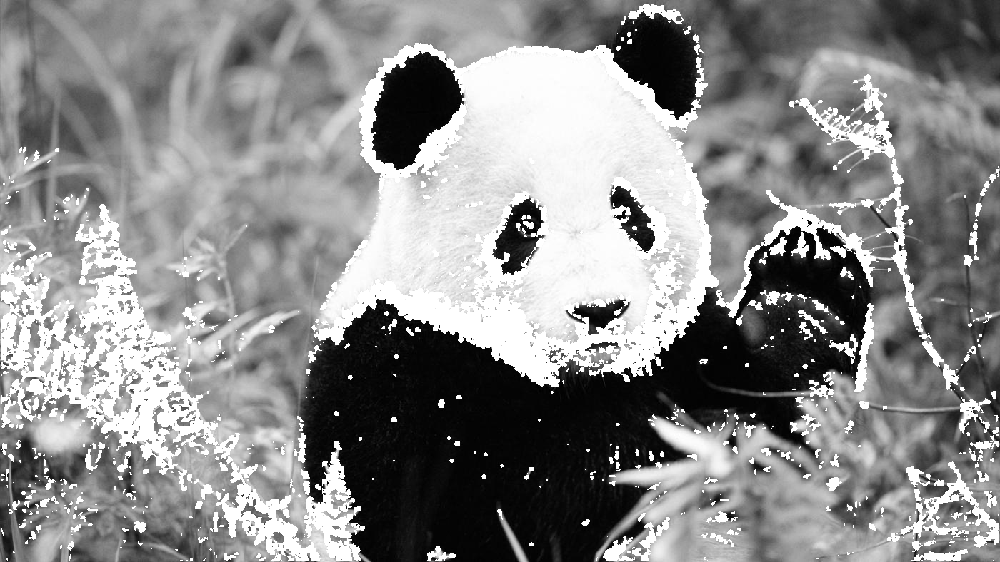

Number of Corners  148361
Output Image for window size  5


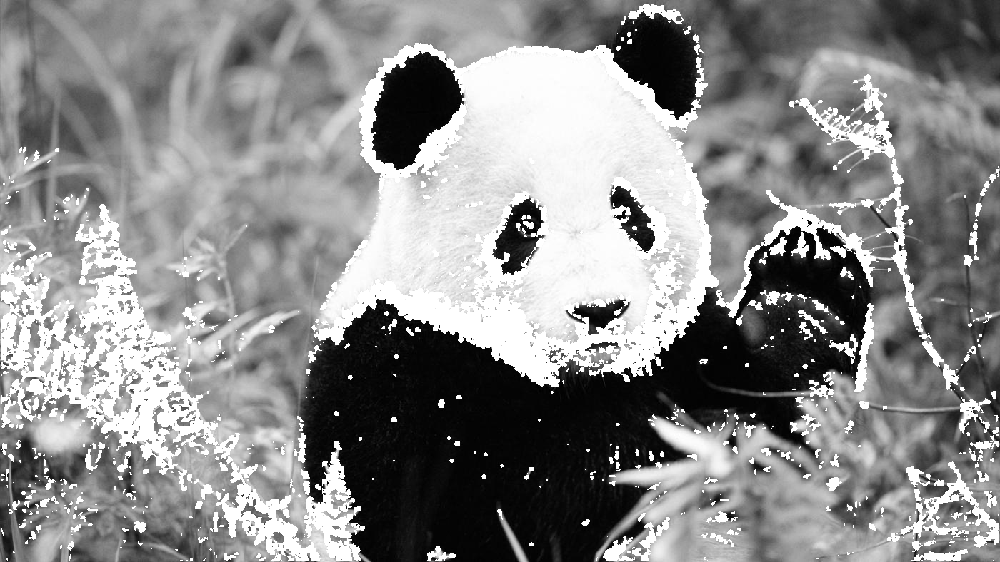

Number of Corners  148361
Output Image for window size  6


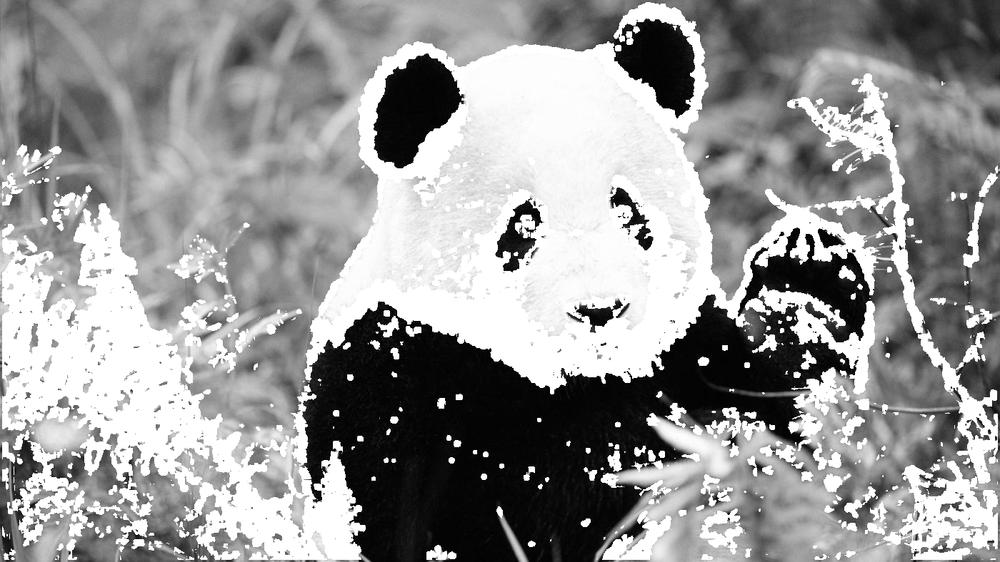

Number of Corners  258833
Output Image for window size  7


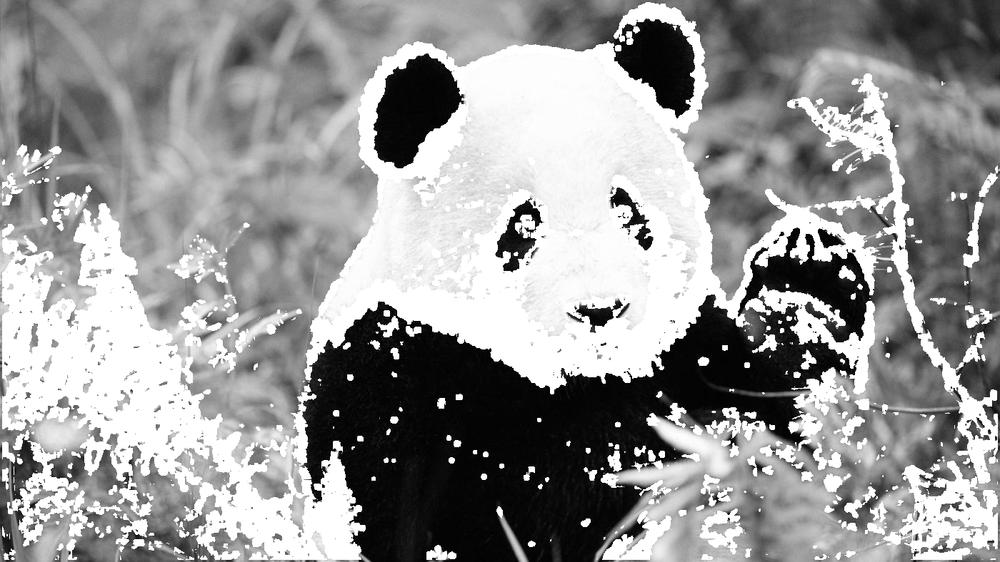

Number of Corners  258833
Output Image for window size  8


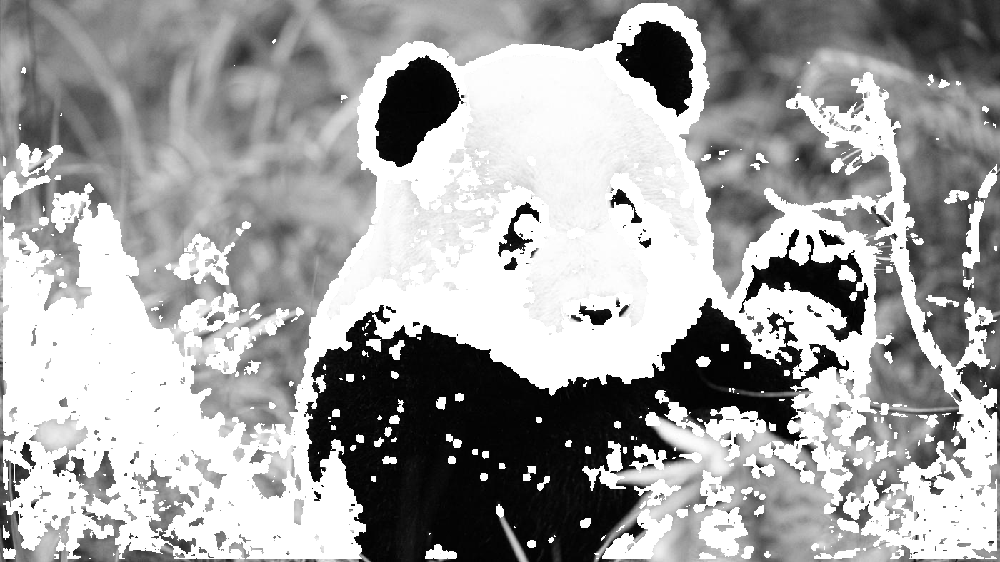

Number of Corners  361178
Output Image for window size  9


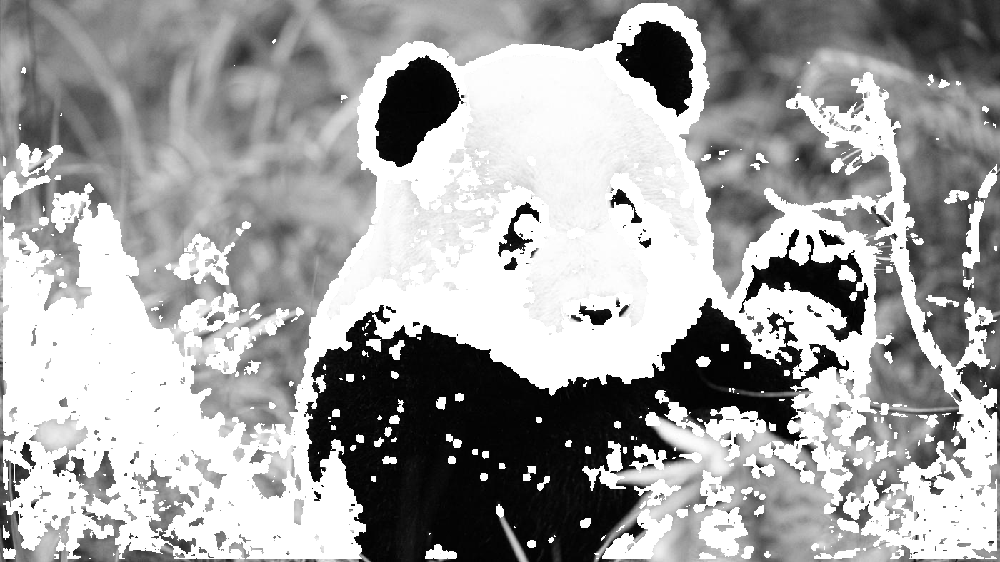

Number of Corners  361178


In [ ]:
import matplotlib.pyplot as plt

no_of_corners = []

def scratch_harris(img, i):
    global no_of_corners

    k = 0.04
    window_size = i
    threshold = 0.01 * th #for CORNER DETECTION THIS VALUE SHOUD BE VERY HIGH AS PER HARRIS
    img = cv2.imread("/content/1.jpg",0)
    corner_list, corner_img = find_harris_corners(img, k, window_size, threshold)
    
    print('Output Image for window size ', i)
    cv2_imshow(corner_img)

    print('Number of Corners ',len(corner_list))
    no_of_corners.append(len(corner_list))
    return corner_img

img = []

for i in range(1,10):
    img.append(cv2.imread("/content/1.jpg",0))
    scratch_harris(img,i)

**Graph Visualization on varying the window size**

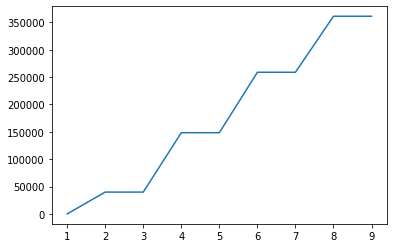

In [ ]:
x = [1,2,3,4,5,6,7,8,9]
plt.plot(x,no_of_corners)

**Graph Visualization with varying threshold values with constant window size 3**

Output Image for window size  1


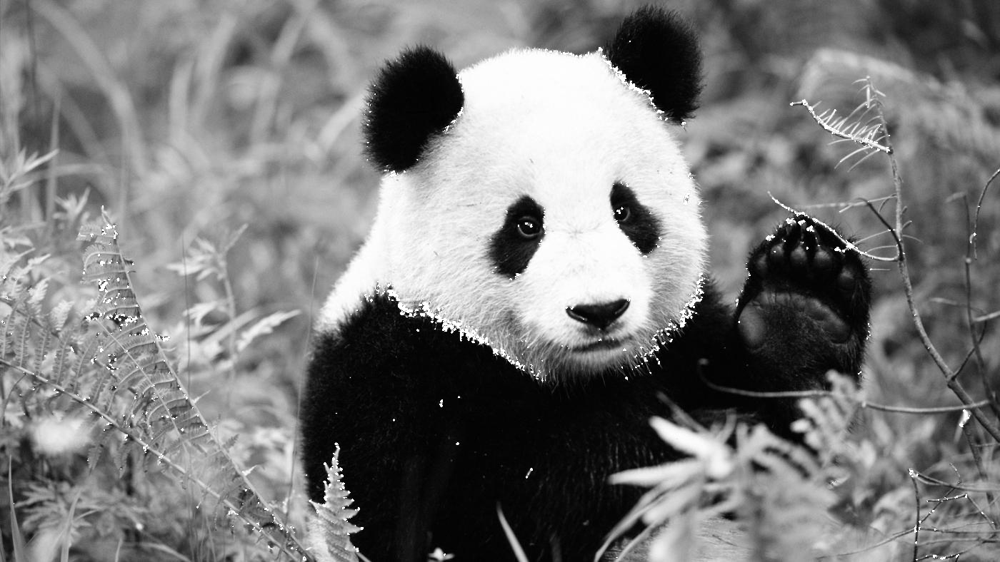

Number of Corners  8265
Output Image for window size  10


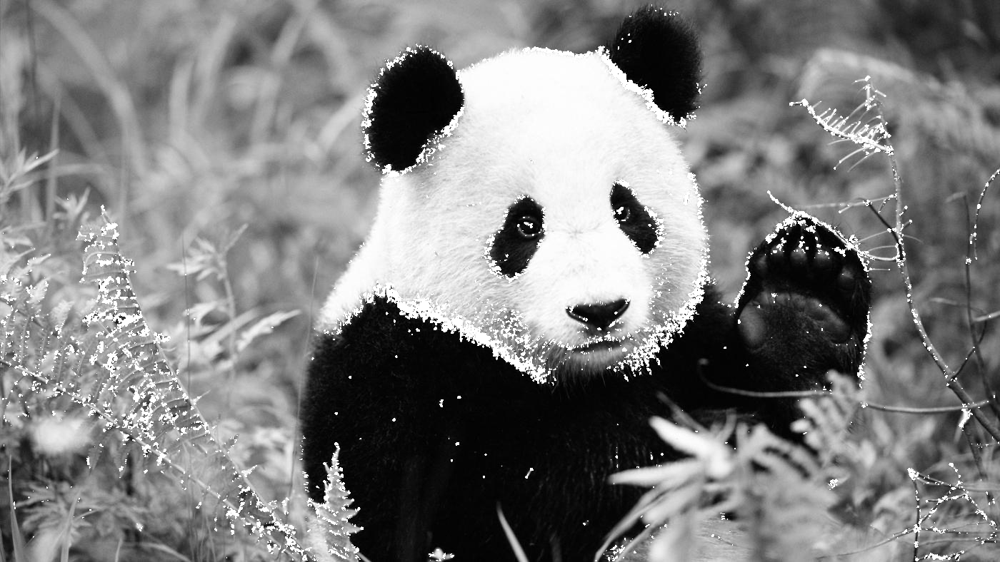

Number of Corners  39885
Output Image for window size  100


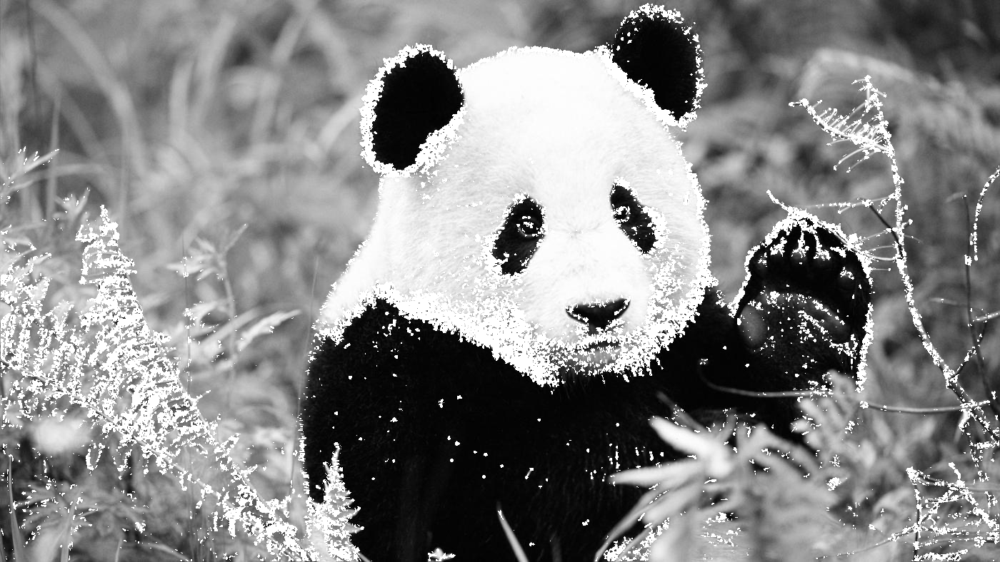

Number of Corners  110747
Output Image for window size  1000


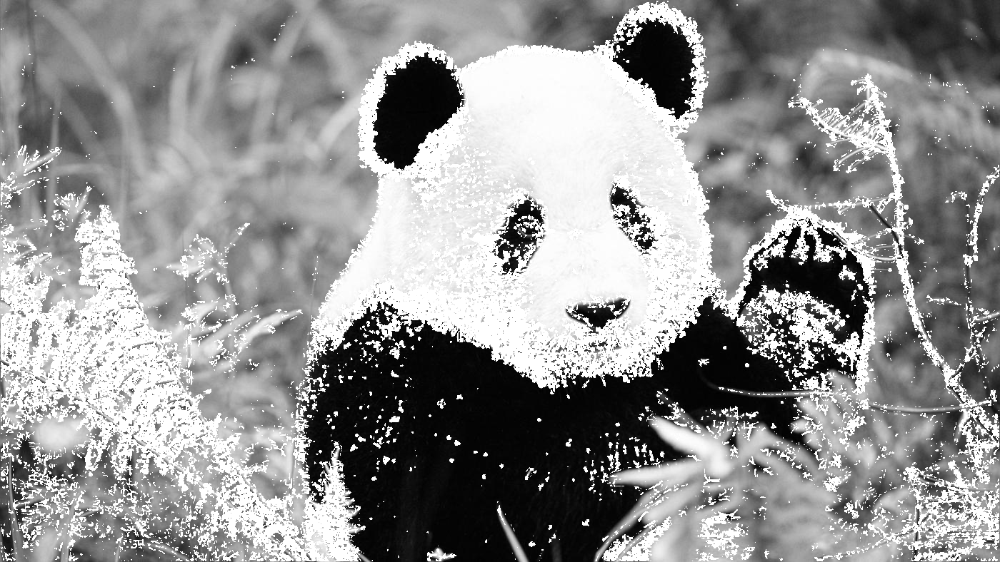

Number of Corners  217072
Output Image for window size  10000


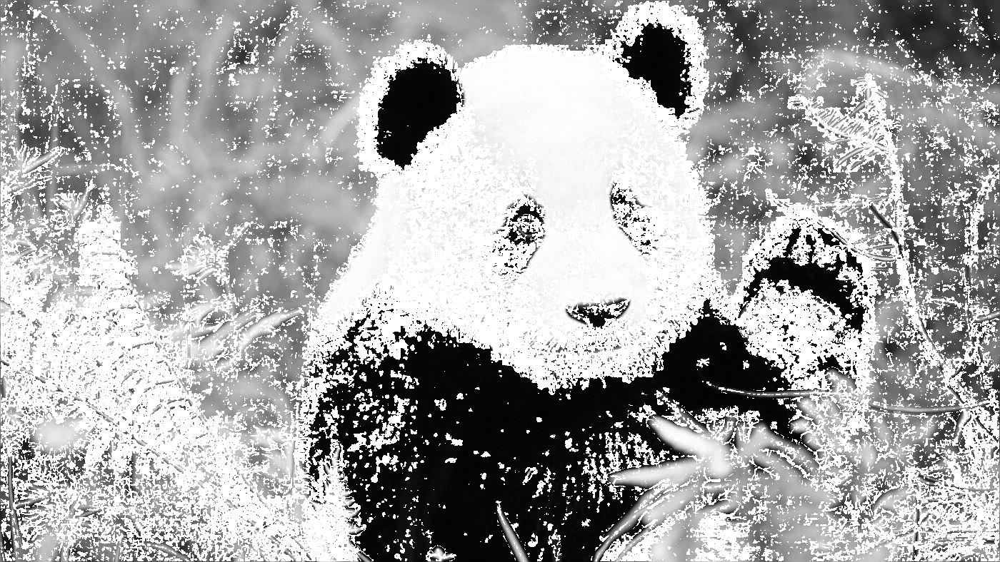

Number of Corners  389399


In [ ]:
import matplotlib.pyplot as plt

no_of_corners = []

def scratch_harris(img, i):
    global no_of_corners

    k = 0.04  
    window_size = 3
    threshold = (0.1/i) * th # 0.1 , 0.01 , 0.001 , 0.0001 , i = 1, 10 ,100, 1000
    img = cv2.imread("/content/1.jpg",0)
    corner_list, corner_img = find_harris_corners(img, k, window_size, threshold)
    
    print('Output Image for Threshold Value ', i)
    cv2_imshow(corner_img)

    print('Number of Corners ',len(corner_list))
    no_of_corners.append(len(corner_list))
    return corner_img

img = []

for i in range(5):
    img.append(cv2.imread("/content/1.jpg",0))
    j = 10**i
    scratch_harris(img,j)

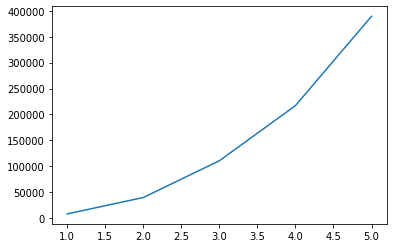

In [ ]:
x = [1,2,3,4,5]
plt.plot(x,no_of_corners)

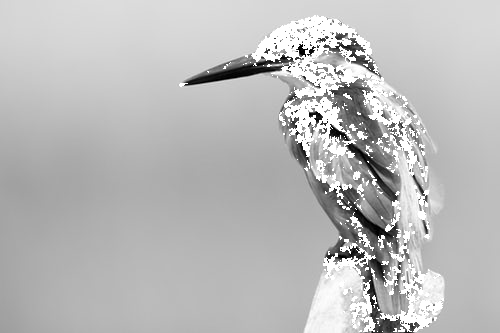

Number of Corners  12113


array([[[212, 212, 212],
        [213, 213, 213],
        [213, 213, 213],
        ...,
        [217, 217, 217],
        [217, 217, 217],
        [217, 217, 217]],

       [[212, 212, 212],
        [213, 213, 213],
        [213, 213, 213],
        ...,
        [217, 217, 217],
        [217, 217, 217],
        [217, 217, 217]],

       [[212, 212, 212],
        [213, 213, 213],
        [213, 213, 213],
        ...,
        [217, 217, 217],
        [217, 217, 217],
        [217, 217, 217]],

       ...,

       [[158, 158, 158],
        [158, 158, 158],
        [158, 158, 158],
        ...,
        [182, 182, 182],
        [182, 182, 182],
        [183, 183, 183]],

       [[158, 158, 158],
        [158, 158, 158],
        [158, 158, 158],
        ...,
        [182, 182, 182],
        [182, 182, 182],
        [183, 183, 183]],

       [[158, 158, 158],
        [158, 158, 158],
        [158, 158, 158],
        ...,
        [182, 182, 182],
        [182, 182, 182],
        [183, 183, 183]]

In [ ]:
img=cv2.imread("/content/2.jpg",0)
scratch_harris(img)

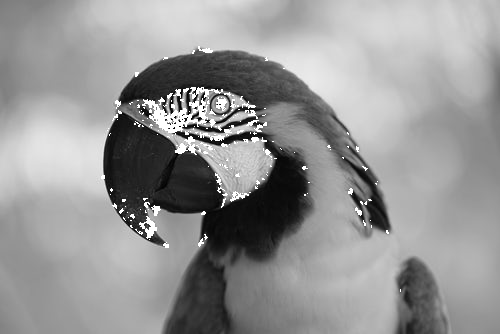

Number of Corners  3187


array([[[123, 123, 123],
        [124, 124, 124],
        [124, 124, 124],
        ...,
        [184, 184, 184],
        [182, 182, 182],
        [181, 181, 181]],

       [[124, 124, 124],
        [124, 124, 124],
        [124, 124, 124],
        ...,
        [184, 184, 184],
        [183, 183, 183],
        [182, 182, 182]],

       [[124, 124, 124],
        [124, 124, 124],
        [125, 125, 125],
        ...,
        [185, 185, 185],
        [184, 184, 184],
        [182, 182, 182]],

       ...,

       [[131, 131, 131],
        [132, 132, 132],
        [132, 132, 132],
        ...,
        [140, 140, 140],
        [140, 140, 140],
        [139, 139, 139]],

       [[131, 131, 131],
        [132, 132, 132],
        [132, 132, 132],
        ...,
        [139, 139, 139],
        [139, 139, 139],
        [139, 139, 139]],

       [[131, 131, 131],
        [132, 132, 132],
        [132, 132, 132],
        ...,
        [140, 140, 140],
        [139, 139, 139],
        [139, 139, 139]]

In [ ]:
img=cv2.imread("/content/3.jpg",0)
scratch_harris(img)

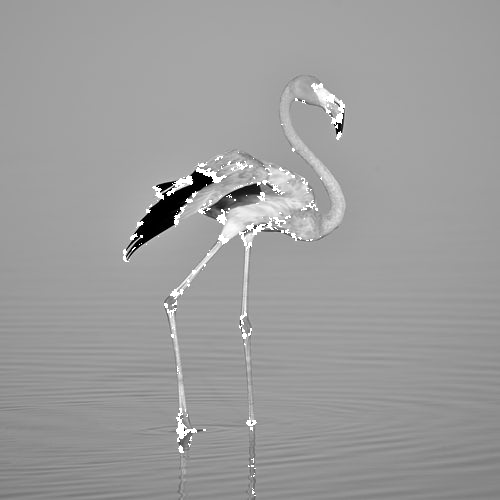

Number of Corners  2752


array([[[154, 154, 154],
        [154, 154, 154],
        [154, 154, 154],
        ...,
        [152, 152, 152],
        [152, 152, 152],
        [152, 152, 152]],

       [[154, 154, 154],
        [154, 154, 154],
        [154, 154, 154],
        ...,
        [153, 153, 153],
        [153, 153, 153],
        [153, 153, 153]],

       [[154, 154, 154],
        [154, 154, 154],
        [154, 154, 154],
        ...,
        [153, 153, 153],
        [153, 153, 153],
        [153, 153, 153]],

       ...,

       [[120, 120, 120],
        [121, 121, 121],
        [121, 121, 121],
        ...,
        [132, 132, 132],
        [132, 132, 132],
        [132, 132, 132]],

       [[128, 128, 128],
        [128, 128, 128],
        [129, 129, 129],
        ...,
        [134, 134, 134],
        [134, 134, 134],
        [134, 134, 134]],

       [[134, 134, 134],
        [135, 135, 135],
        [135, 135, 135],
        ...,
        [135, 135, 135],
        [135, 135, 135],
        [135, 135, 135]]

In [ ]:
img=cv2.imread("/content/4.jpg",0)
scratch_harris(img)

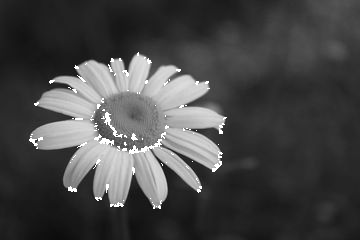

Number of Corners  1155


array([[[38, 38, 38],
        [38, 38, 38],
        [37, 37, 37],
        ...,
        [73, 73, 73],
        [73, 73, 73],
        [73, 73, 73]],

       [[38, 38, 38],
        [38, 38, 38],
        [37, 37, 37],
        ...,
        [73, 73, 73],
        [72, 72, 72],
        [73, 73, 73]],

       [[38, 38, 38],
        [37, 37, 37],
        [37, 37, 37],
        ...,
        [72, 72, 72],
        [72, 72, 72],
        [72, 72, 72]],

       ...,

       [[28, 28, 28],
        [28, 28, 28],
        [28, 28, 28],
        ...,
        [26, 26, 26],
        [26, 26, 26],
        [26, 26, 26]],

       [[28, 28, 28],
        [28, 28, 28],
        [28, 28, 28],
        ...,
        [26, 26, 26],
        [25, 25, 25],
        [25, 25, 25]],

       [[28, 28, 28],
        [28, 28, 28],
        [27, 27, 27],
        ...,
        [25, 25, 25],
        [25, 25, 25],
        [25, 25, 25]]], dtype=uint8)

In [ ]:
img=cv2.imread("/content/5.jpg",0)
scratch_harris(img)

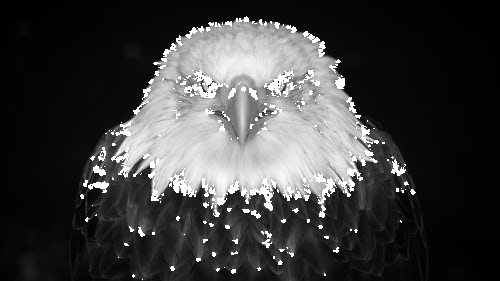

Number of Corners  5942


array([[[1, 1, 1],
        [1, 1, 1],
        [1, 1, 1],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [1, 1, 1]],

       [[1, 1, 1],
        [1, 1, 1],
        [1, 1, 1],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [1, 1, 1]],

       [[1, 1, 1],
        [1, 1, 1],
        [1, 1, 1],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [1, 1, 1]],

       ...,

       [[3, 3, 3],
        [3, 3, 3],
        [3, 3, 3],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [1, 1, 1]],

       [[3, 3, 3],
        [3, 3, 3],
        [3, 3, 3],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [1, 1, 1]],

       [[3, 3, 3],
        [3, 3, 3],
        [3, 3, 3],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [1, 1, 1]]], dtype=uint8)

In [ ]:
img=cv2.imread("/content/6.jpg",0)
scratch_harris(img)

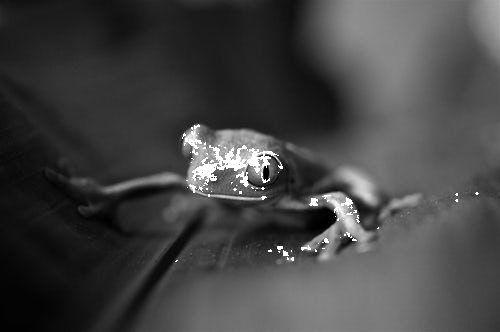

Number of Corners  1850


array([[[ 21,  21,  21],
        [ 21,  21,  21],
        [ 20,  20,  20],
        ...,
        [167, 167, 167],
        [170, 170, 170],
        [175, 175, 175]],

       [[ 22,  22,  22],
        [ 22,  22,  22],
        [ 21,  21,  21],
        ...,
        [165, 165, 165],
        [168, 168, 168],
        [173, 173, 173]],

       [[ 24,  24,  24],
        [ 23,  23,  23],
        [ 23,  23,  23],
        ...,
        [166, 166, 166],
        [169, 169, 169],
        [173, 173, 173]],

       ...,

       [[  2,   2,   2],
        [  2,   2,   2],
        [  2,   2,   2],
        ...,
        [ 54,  54,  54],
        [ 53,  53,  53],
        [ 54,  54,  54]],

       [[  2,   2,   2],
        [  2,   2,   2],
        [  2,   2,   2],
        ...,
        [ 54,  54,  54],
        [ 54,  54,  54],
        [ 54,  54,  54]],

       [[  2,   2,   2],
        [  2,   2,   2],
        [  2,   2,   2],
        ...,
        [ 55,  55,  55],
        [ 54,  54,  54],
        [ 55,  55,  55]]

In [ ]:
img=cv2.imread("/content/7.jpg",0)
scratch_harris(img)

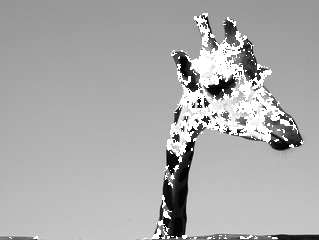

Number of Corners  5432


array([[[149, 149, 149],
        [149, 149, 149],
        [149, 149, 149],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       [[149, 149, 149],
        [149, 149, 149],
        [149, 149, 149],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       [[149, 149, 149],
        [149, 149, 149],
        [149, 149, 149],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       ...,

       [[123, 123, 123],
        [123, 123, 123],
        [120, 120, 120],
        ...,
        [ 21,  21,  21],
        [ 21,  21,  21],
        [ 20,  20,  20]],

       [[132, 132, 132],
        [130, 130, 130],
        [126, 126, 126],
        ...,
        [ 23,  23,  23],
        [ 23,  23,  23],
        [ 23,  23,  23]],

       [[121, 121, 121],
        [120, 120, 120],
        [119, 119, 119],
        ...,
        [ 22,  22,  22],
        [ 22,  22,  22],
        [ 21,  21,  21]]

In [ ]:
img=cv2.imread("/content/8.jpg",0)
scratch_harris(img)

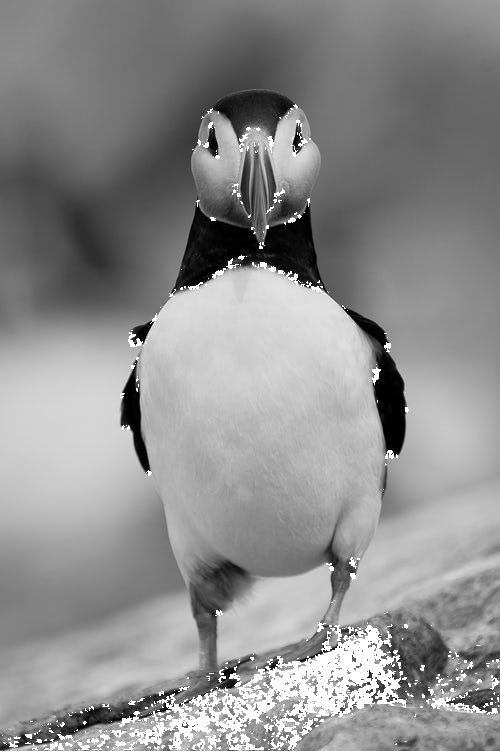

Number of Corners  14952


array([[[132, 132, 132],
        [132, 132, 132],
        [132, 132, 132],
        ...,
        [153, 153, 153],
        [153, 153, 153],
        [153, 153, 153]],

       [[132, 132, 132],
        [132, 132, 132],
        [132, 132, 132],
        ...,
        [152, 152, 152],
        [152, 152, 152],
        [152, 152, 152]],

       [[132, 132, 132],
        [132, 132, 132],
        [132, 132, 132],
        ...,
        [152, 152, 152],
        [152, 152, 152],
        [152, 152, 152]],

       ...,

       [[ 36,  36,  36],
        [ 33,  33,  33],
        [ 32,  32,  32],
        ...,
        [114, 114, 114],
        [111, 111, 111],
        [111, 111, 111]],

       [[ 34,  34,  34],
        [ 34,  34,  34],
        [ 36,  36,  36],
        ...,
        [108, 108, 108],
        [105, 105, 105],
        [105, 105, 105]],

       [[ 70,  70,  70],
        [ 76,  76,  76],
        [ 84,  84,  84],
        ...,
        [108, 108, 108],
        [104, 104, 104],
        [105, 105, 105]]

In [ ]:
img=cv2.imread("/content/9.jpg",0)
scratch_harris(img)

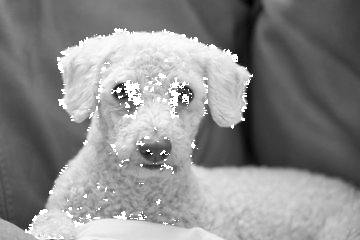

Number of Corners  2498


array([[[141, 141, 141],
        [138, 138, 138],
        [134, 134, 134],
        ...,
        [ 56,  56,  56],
        [ 56,  56,  56],
        [ 56,  56,  56]],

       [[140, 140, 140],
        [137, 137, 137],
        [133, 133, 133],
        ...,
        [ 56,  56,  56],
        [ 56,  56,  56],
        [ 56,  56,  56]],

       [[138, 138, 138],
        [136, 136, 136],
        [133, 133, 133],
        ...,
        [ 56,  56,  56],
        [ 56,  56,  56],
        [ 56,  56,  56]],

       ...,

       [[165, 165, 165],
        [162, 162, 162],
        [160, 160, 160],
        ...,
        [169, 169, 169],
        [172, 172, 172],
        [173, 173, 173]],

       [[167, 167, 167],
        [162, 162, 162],
        [159, 159, 159],
        ...,
        [172, 172, 172],
        [169, 169, 169],
        [166, 166, 166]],

       [[168, 168, 168],
        [163, 163, 163],
        [159, 159, 159],
        ...,
        [170, 170, 170],
        [163, 163, 163],
        [158, 158, 158]]

In [ ]:
img=cv2.imread("/content/10.jpg",0)
scratch_harris(img)

# **3. Camera Calibration**

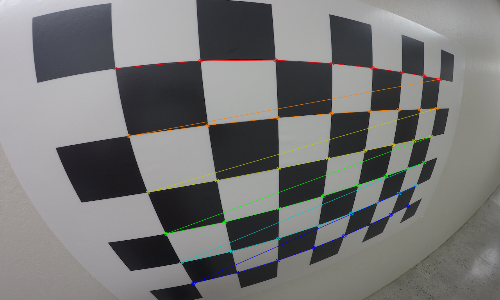

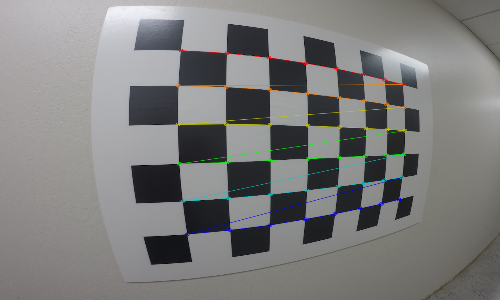

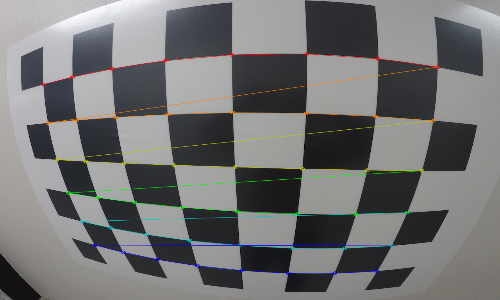

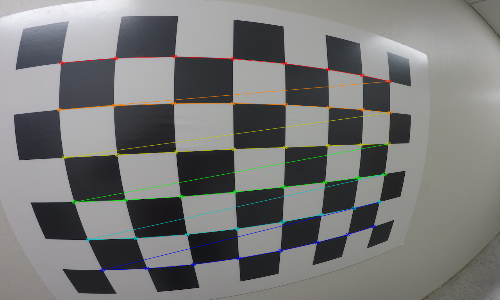

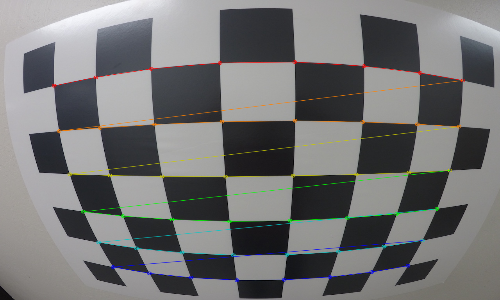

...

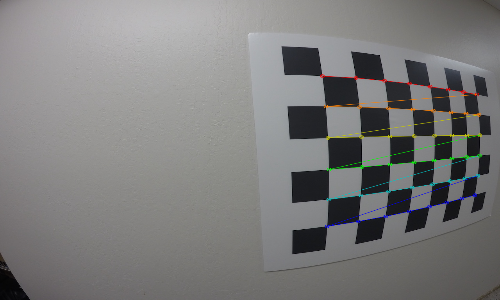

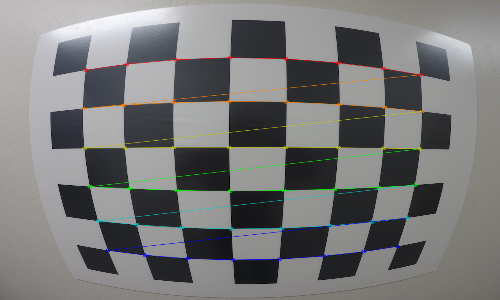

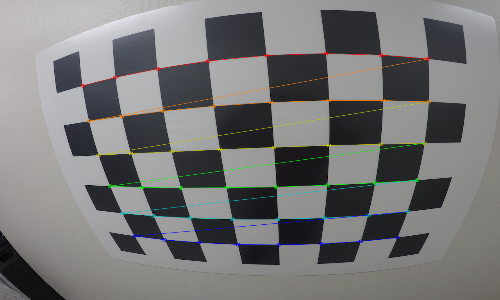

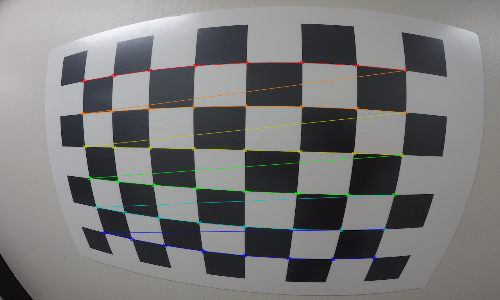

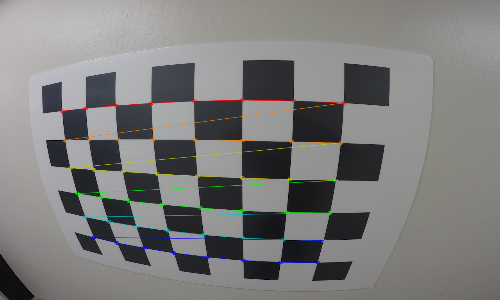

In [ ]:
import numpy as np
import cv2
import glob

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

images = glob.glob('*.jpg')

for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray, (8,6),None)

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (8,6), corners2,ret)
        img = cv2.resize(img,(500,300))
        cv2_imshow(img)

In [ ]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
print('Intrinsic Matrix')
print(mtx)
print('\n Distortion Matrix')
print(dist)

Intrinsic Matrix
[[559.66086702   0.         651.12251224]
 [  0.         560.74158563 498.77835168]
 [  0.           0.           1.        ]]

 Distortion Matrix
[[-2.32230232e-01  6.13449663e-02  4.37961599e-06  5.48089827e-05
  -7.48458246e-03]]


(1280, 960)


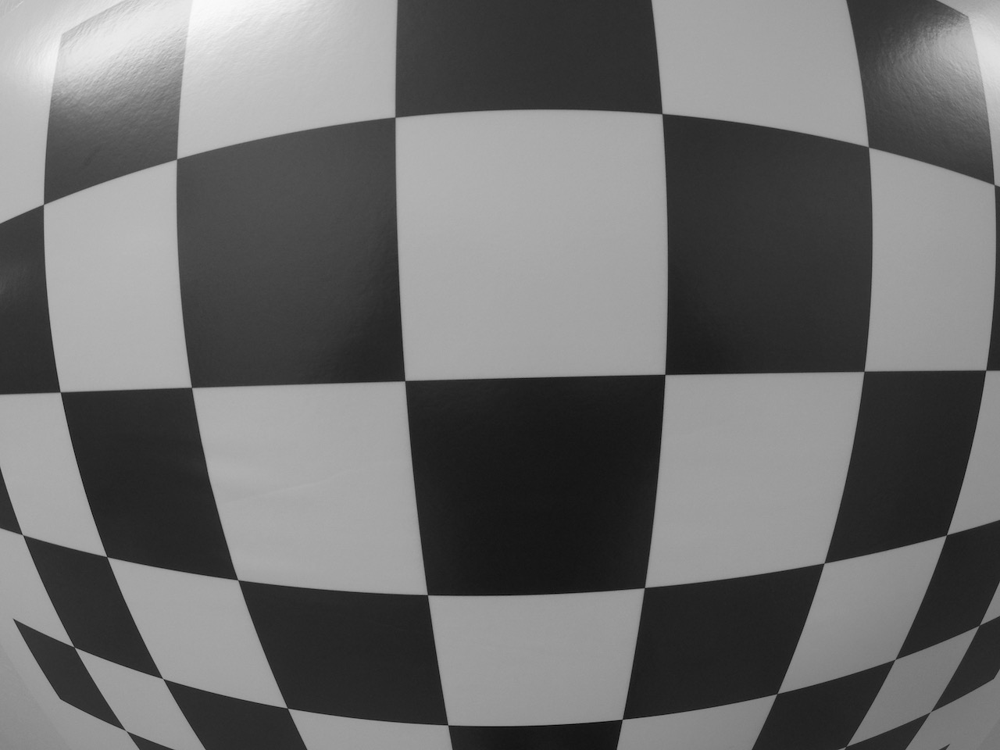

In [ ]:
print(gray.shape[::-1])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
img = cv2.imread('test_image.jpg',0)
cv2_imshow(img)
h,  w = img.shape[:2]
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

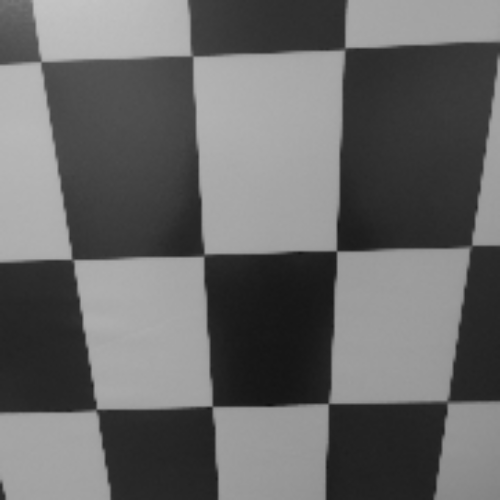

In [ ]:
# undistort
dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
#cv2_imshow(dst) #bad output

# crop the image
x,y,w,h = roi
dst = dst[y:y+h, x:x+w]
dst=cv2.resize(dst,(500,500))
cv2_imshow(dst)

# **4. Morphological operations**

**Example taken in Class Implementation**

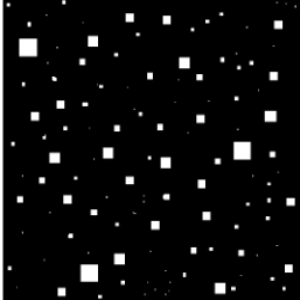

In [ ]:
imgc = cv.imread('cvclass.png',0)
imgc = cv2.resize(imgc,(300,300))
cv2_imshow(imgc)

**Erosion**

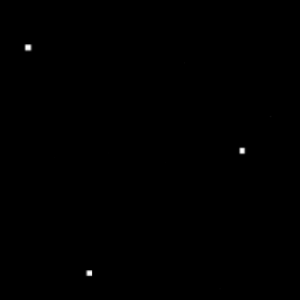

In [ ]:
imgc = cv.imread('cvclass.png',0)
imgc = cv2.resize(imgc,(300,300))
kernel = np.ones((13,13),np.uint8)

erosion = cv.erode(imgc,kernel,iterations = 1)
cv2_imshow(erosion)

**Dilation**

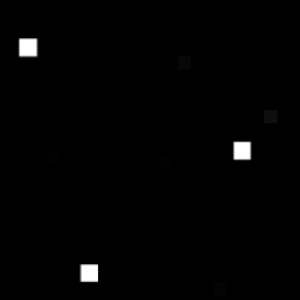

In [ ]:
dilation = cv.dilate(erosion,kernel,iterations = 1)
cv2_imshow(dilation)

**Assignment Images**

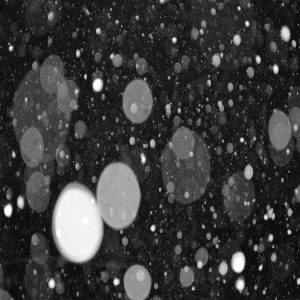

In [ ]:
img = cv.imread('1.jpg',0)
img=cv2.resize(img,(300,300))
cv2_imshow(img)

**Erosion**

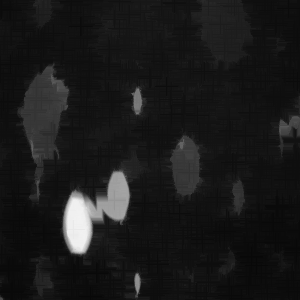

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('1.jpg',0)
img=cv2.resize(img,(300,300))
kernel = np.array([[0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
                   [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0]], np.uint8)

erosion = cv.erode(img,kernel,iterations = 1)
cv2_imshow(erosion)

**Dilation**

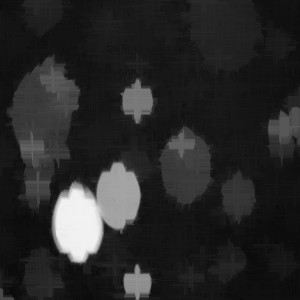

In [ ]:
dilation = cv.dilate(erosion,kernel,iterations = 1)
cv2_imshow(dilation)

**Opening - Weaking the bridge in the eroded image, Removal of thin connections and small intrutions**

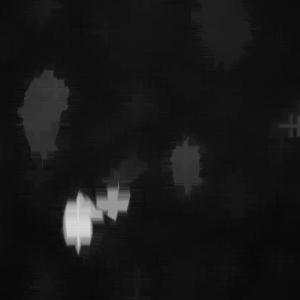

In [ ]:
opening = cv.morphologyEx(erosion, cv.MORPH_OPEN, kernel)
cv2_imshow(opening)

**Closing - Closing the inner holes and making the bridge Stronger**

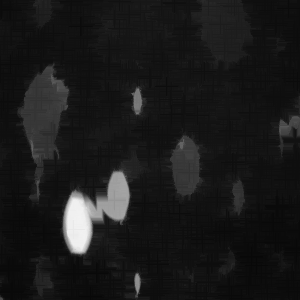

In [ ]:
closing = cv.morphologyEx(erosion, cv.MORPH_CLOSE, kernel)
cv2_imshow(closing)

**Gradient : Outputs the Edges ( by calulating the gradient change)**

---

**Calculating on Dilation so as to visualize better**

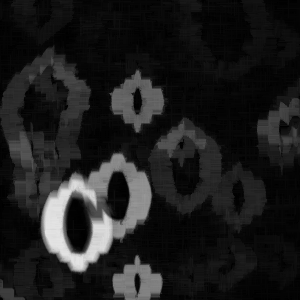

In [ ]:
gradient = cv.morphologyEx(dilation, cv.MORPH_GRADIENT, kernel)
cv2_imshow(gradient)

**Tophat : Top gradient of the objects**

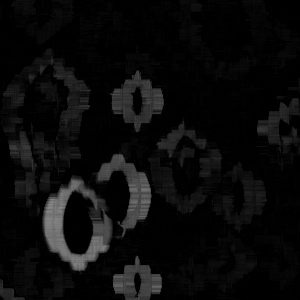

In [ ]:
tophat = cv.morphologyEx(gradient, cv.MORPH_TOPHAT, kernel)
cv2_imshow(tophat)

**Blackhat : Difference of Original Image and the Closing**

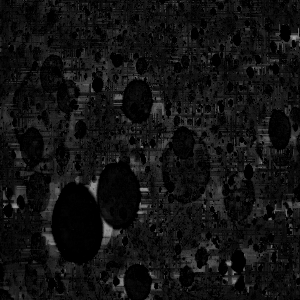

In [ ]:
blackhat = cv.morphologyEx(img, cv.MORPH_BLACKHAT, kernel)
cv2_imshow(blackhat)

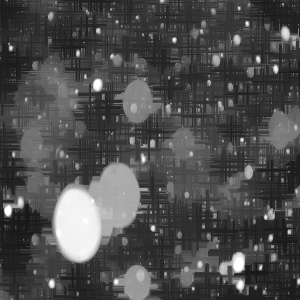

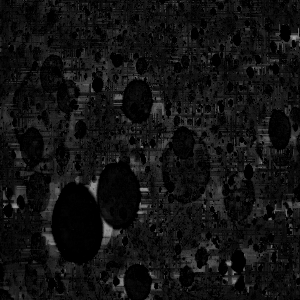

In [ ]:
closing2 = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel)
cv2_imshow(closing2)

blackhat_try = closing2 - img
cv2_imshow(blackhat_try)

**Experimenting Ahead with Structuring Elements**

## **IMAGE 1**

ORIGINAL


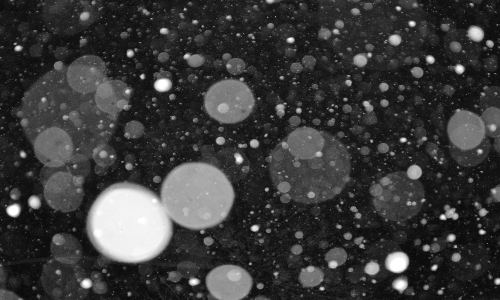

[[0 1]
 [1 1]]
EROSION


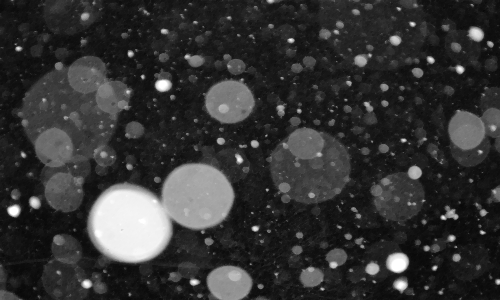

DILATION


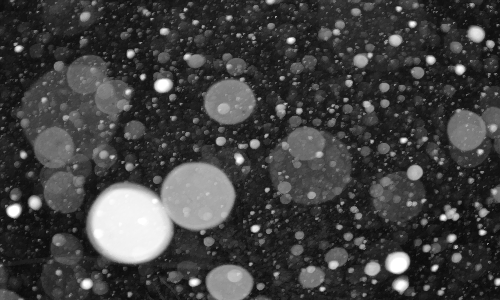

OPENING


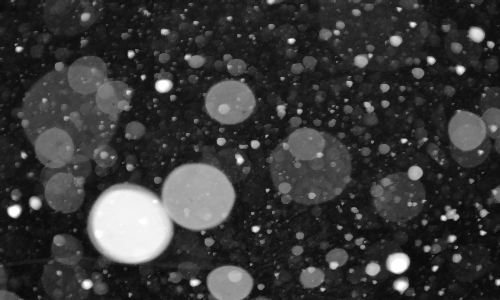

CLOSING


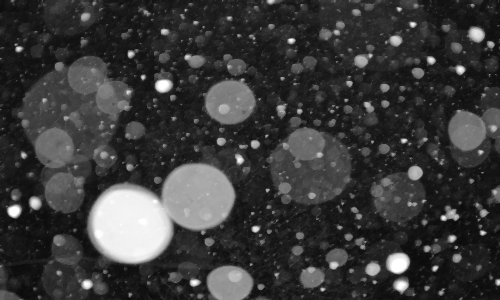

GRADIENT


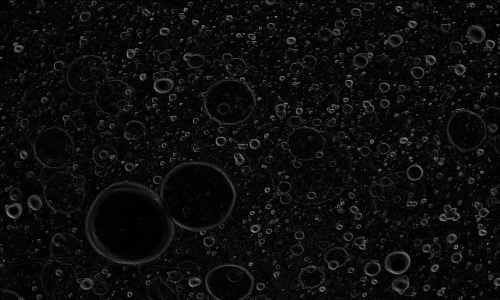

TOPHAT


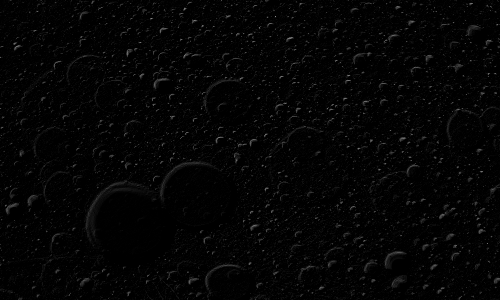

BLACKHAT


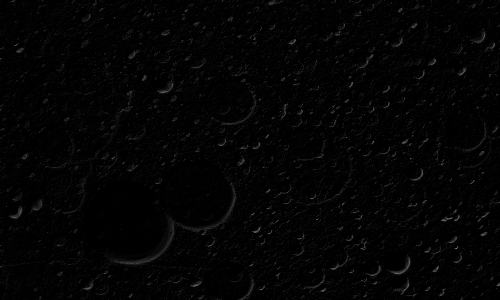

In [ ]:
img = cv2.imread('1.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(2,2))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


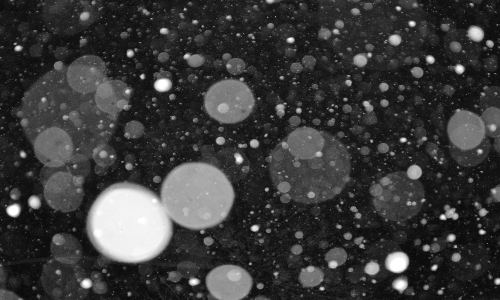

[[0 0 1 0]
 [1 1 1 1]
 [1 1 1 1]
 [1 1 1 1]]
EROSION


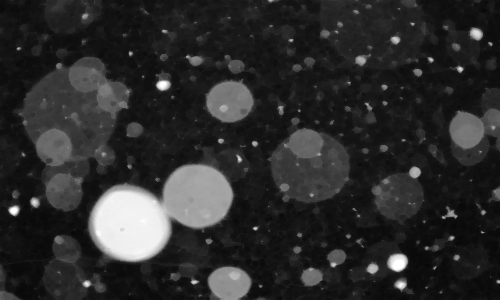

DILATION


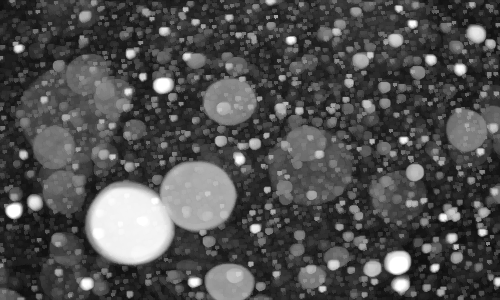

OPENING


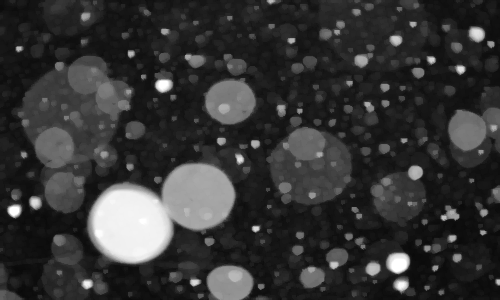

CLOSING


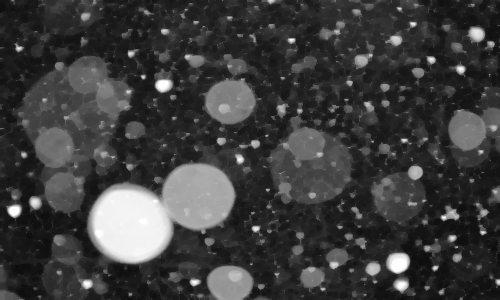

GRADIENT


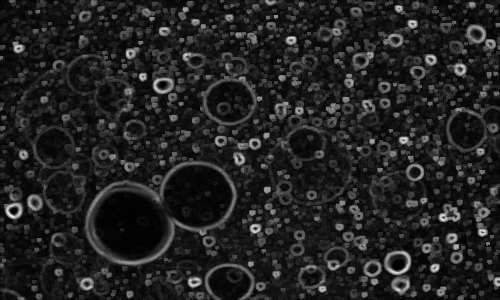

TOPHAT


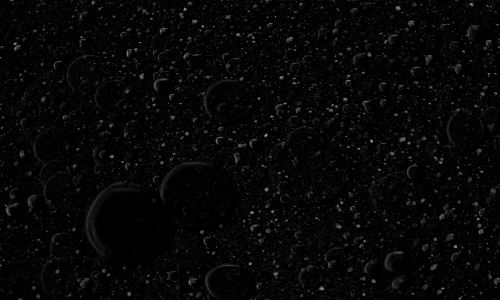

BLACKHAT


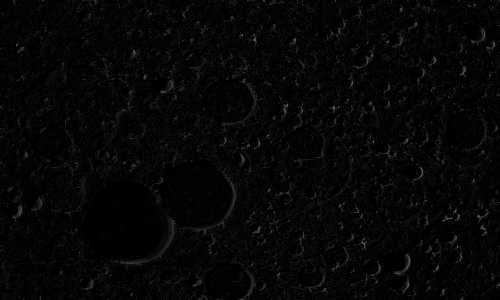

In [ ]:
img = cv2.imread('1.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(4,4))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


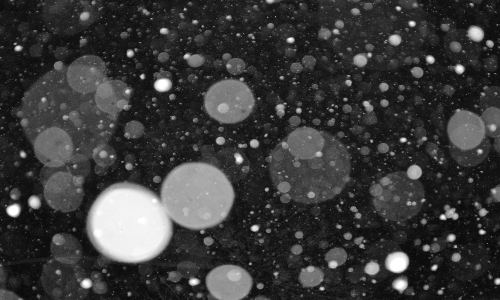

[[0 0 1 0 0]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [0 0 1 0 0]]
EROSION


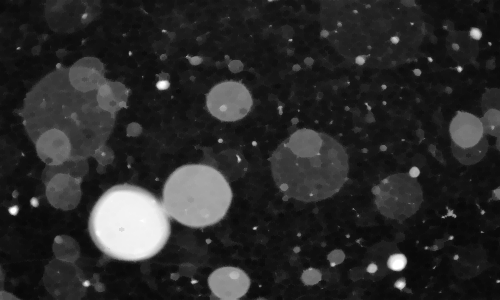

DILATION


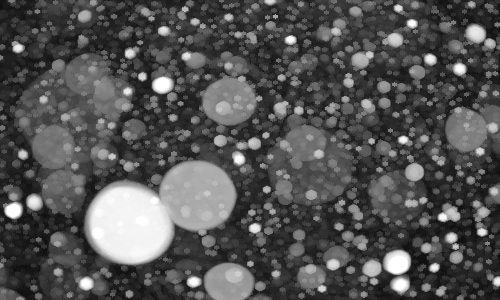

OPENING


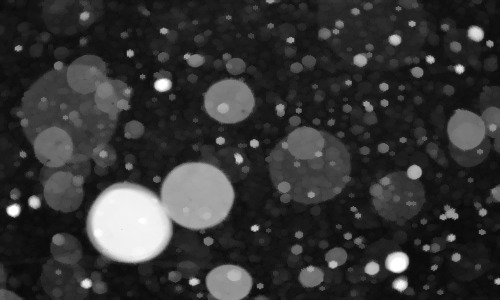

CLOSING


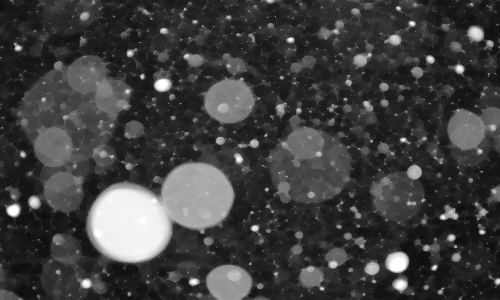

GRADIENT


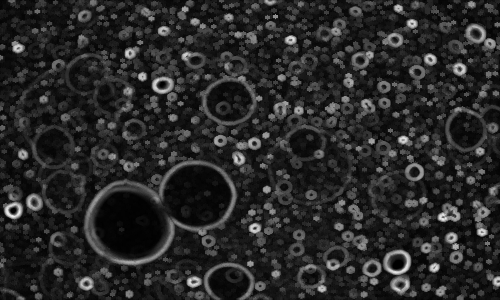

TOPHAT


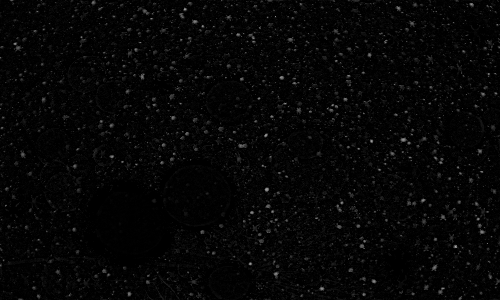

BLACKHAT


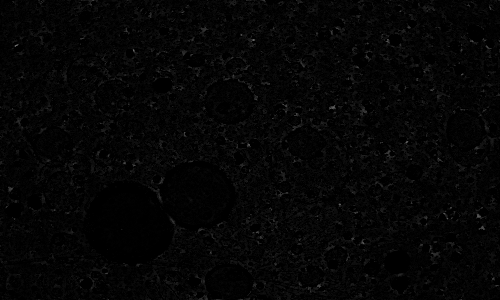

In [ ]:
img = cv2.imread('1.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


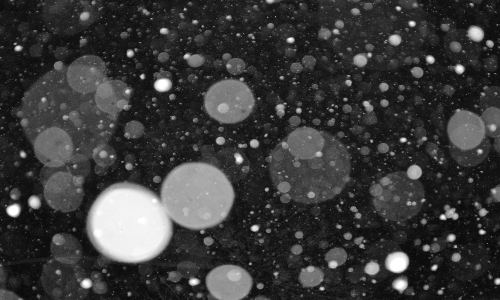

[[0 0 0 1 0 0 0]
 [0 1 1 1 1 1 0]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [0 1 1 1 1 1 0]
 [0 0 0 1 0 0 0]]
EROSION


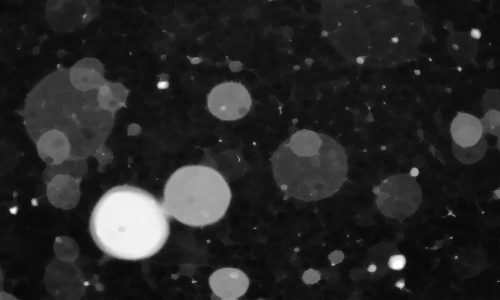

DILATION


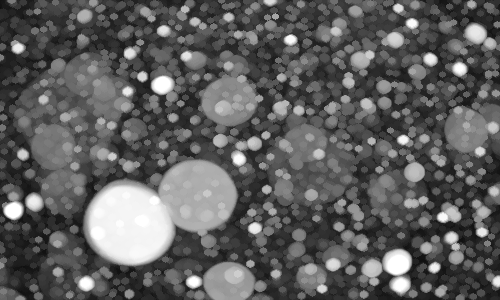

OPENING


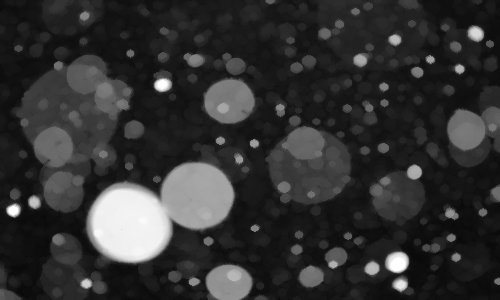

CLOSING


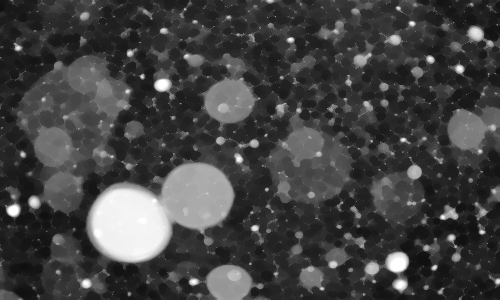

GRADIENT


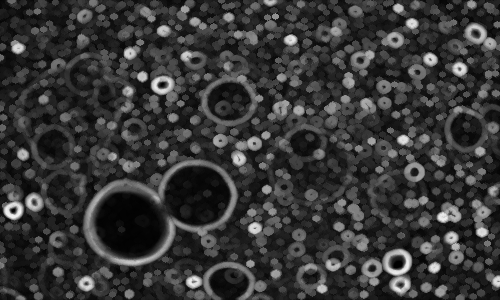

TOPHAT


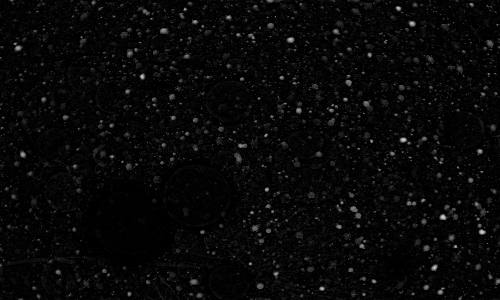

BLACKHAT


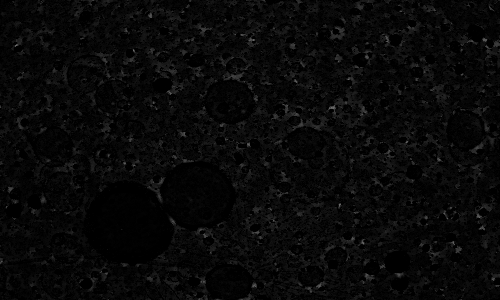

In [ ]:
img = cv2.imread('1.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(7,7))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

## **IMAGE 2**

ORIGINAL


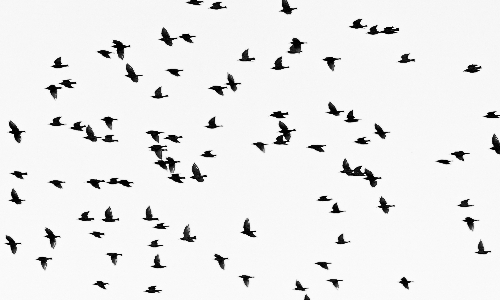

[[0 1]
 [1 1]]
EROSION


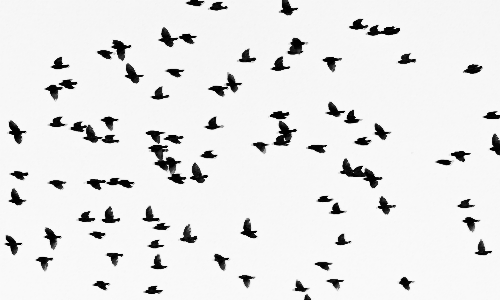

DILATION


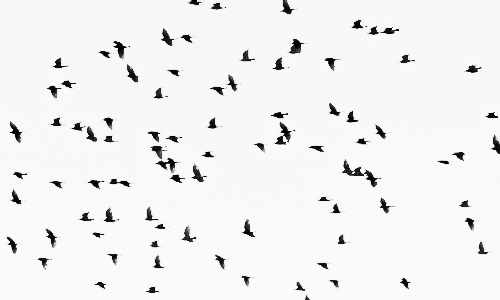

OPENING


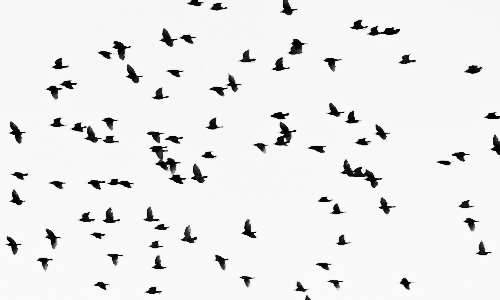

CLOSING


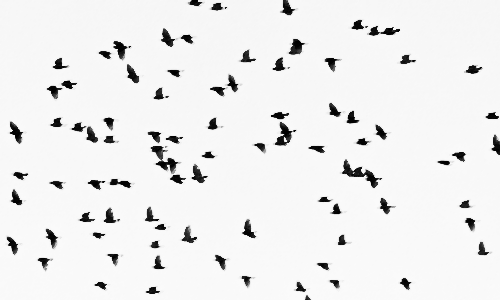

GRADIENT


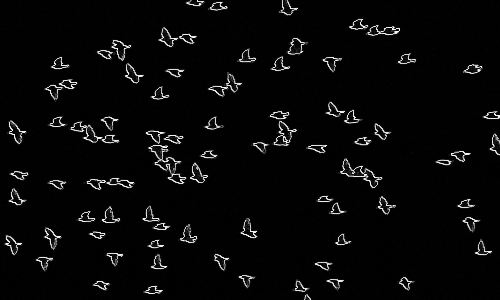

TOPHAT


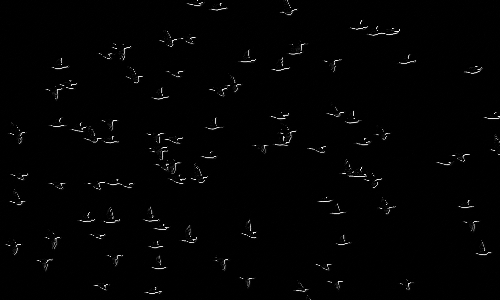

BLACKHAT


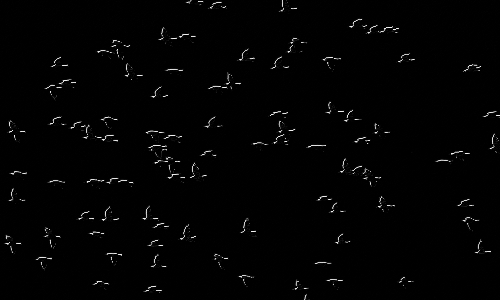

In [ ]:
img = cv2.imread('2.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(2,2))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


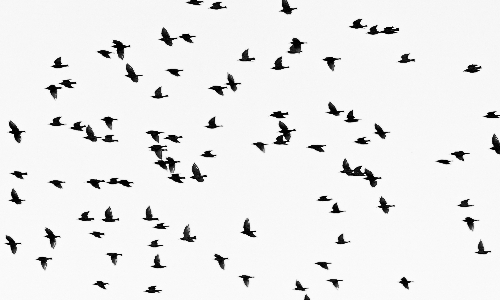

[[0 1 0]
 [1 1 1]
 [0 1 0]]
EROSION


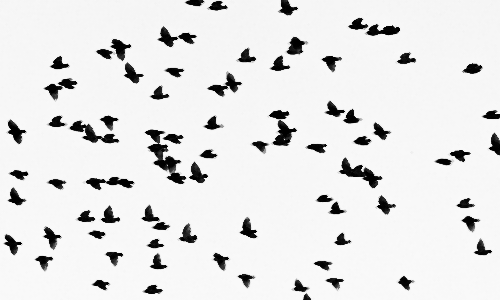

DILATION


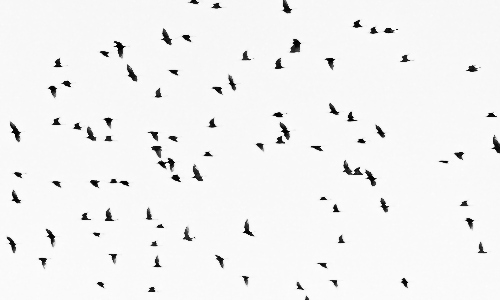

OPENING


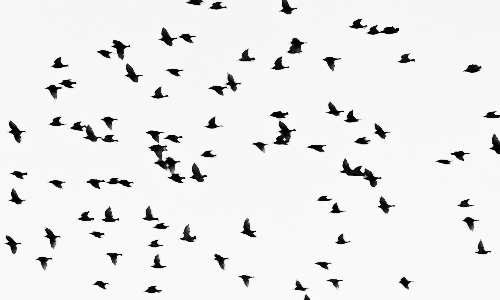

CLOSING


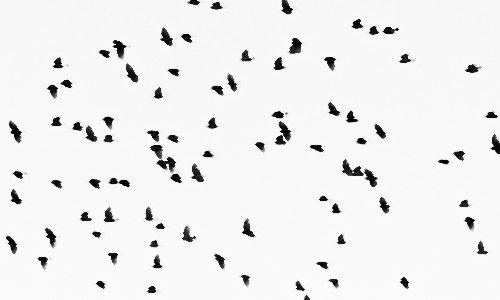

GRADIENT


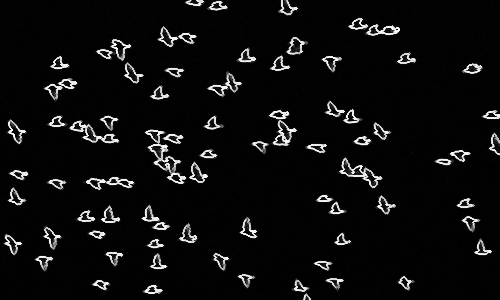

TOPHAT


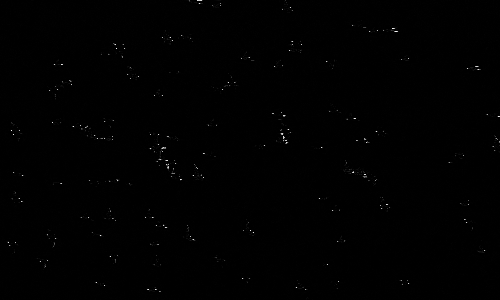

BLACKHAT


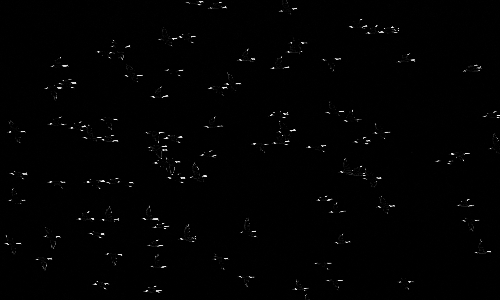

In [ ]:
img = cv2.imread('2.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


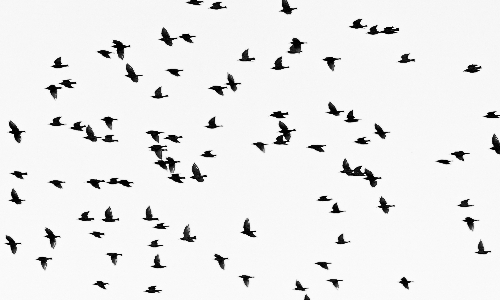

[[0 0 1 0]
 [0 0 1 0]
 [1 1 1 1]
 [0 0 1 0]]
EROSION


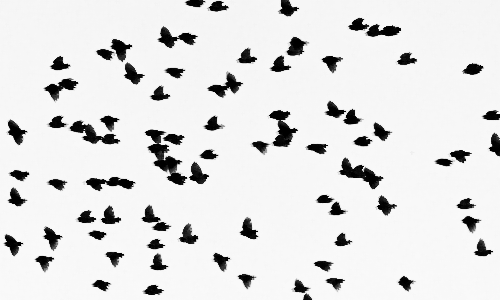

DILATION


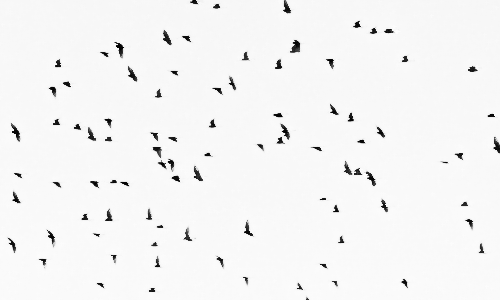

OPENING


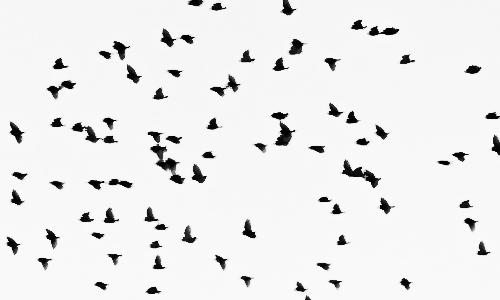

CLOSING


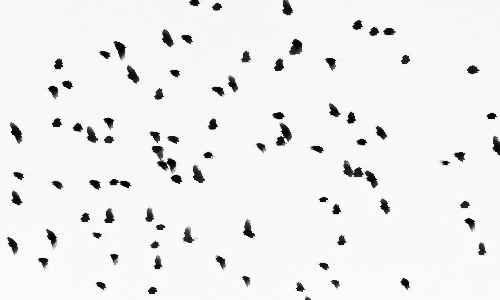

GRADIENT


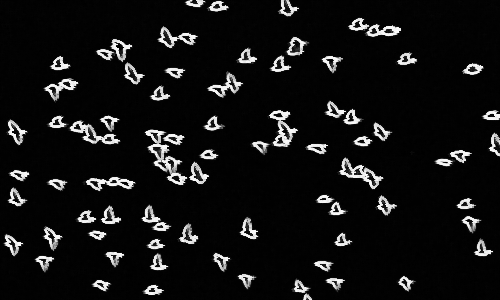

TOPHAT


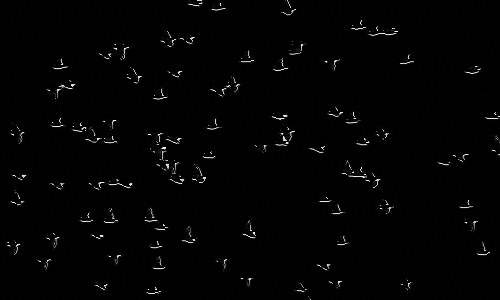

BLACKHAT


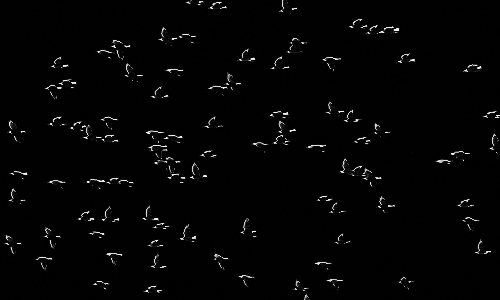

In [ ]:
img = cv2.imread('2.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(4,4))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

**Adding Screenshot from my report for the intresting observation**

---

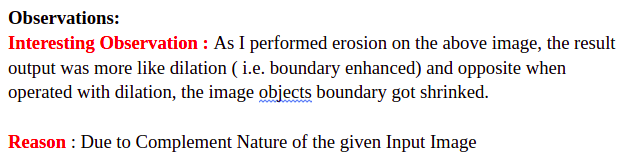

## **IMAGE 3**

ORIGINAL


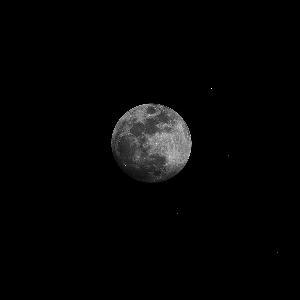

[[0 1]
 [1 1]]
EROSION


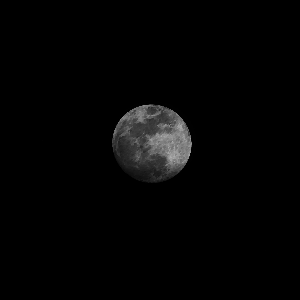

DILATION


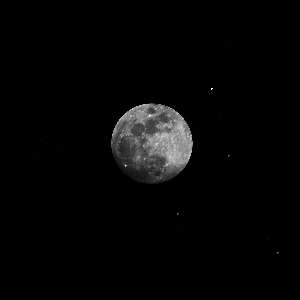

OPENING


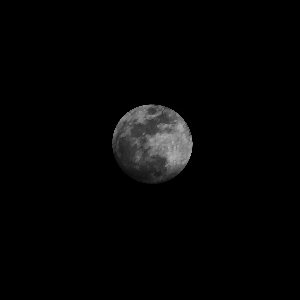

CLOSING


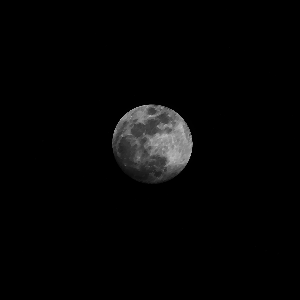

GRADIENT


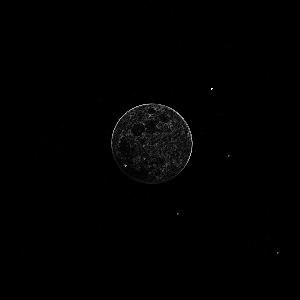

TOPHAT


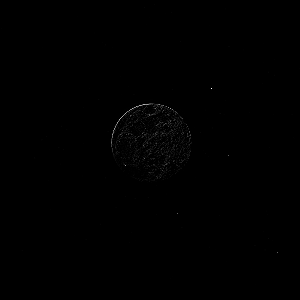

BLACKHAT


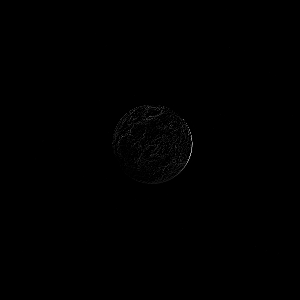

In [ ]:
img = cv2.imread('3.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(2,2))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


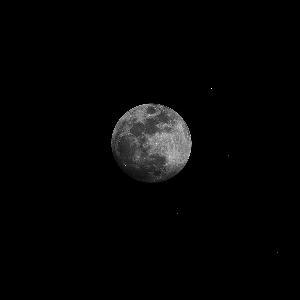

[[0 0 1 0]
 [1 1 1 1]
 [1 1 1 1]
 [1 1 1 1]]
EROSION


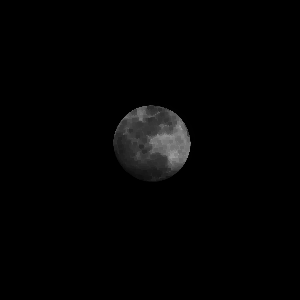

DILATION


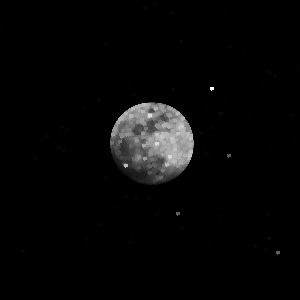

OPENING


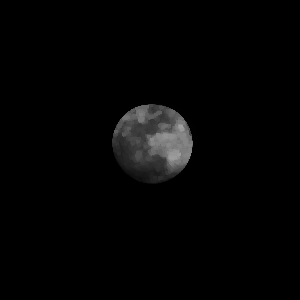

CLOSING


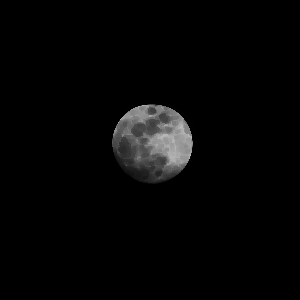

GRADIENT


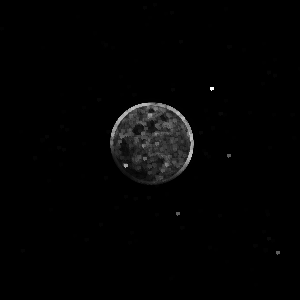

TOPHAT


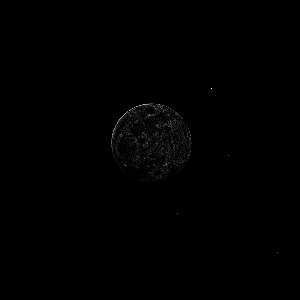

BLACKHAT


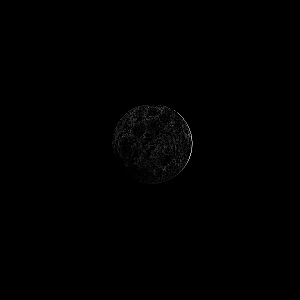

In [ ]:
img = cv2.imread('3.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(4,4))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


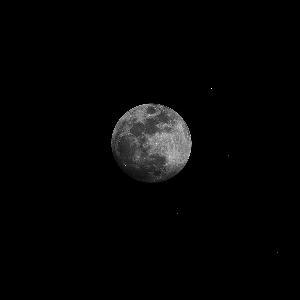

[[0 0 0 1 0 0]
 [0 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [0 1 1 1 1 1]]
EROSION


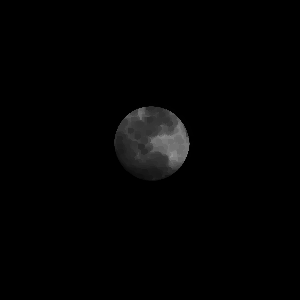

DILATION


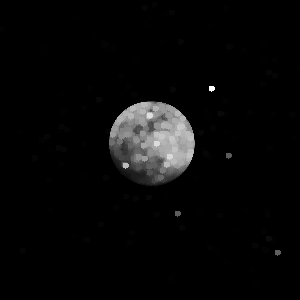

OPENING


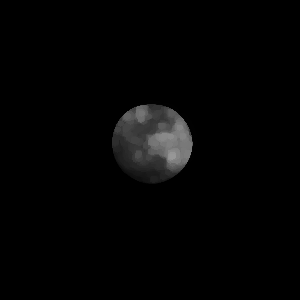

CLOSING


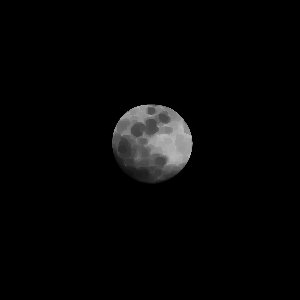

GRADIENT


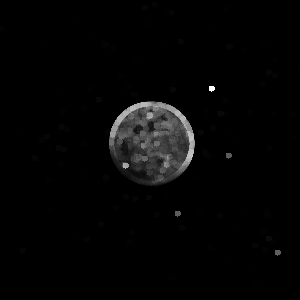

TOPHAT


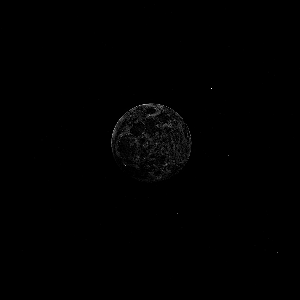

BLACKHAT


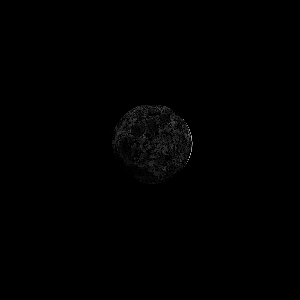

In [ ]:
img = cv2.imread('3.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(6,6))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


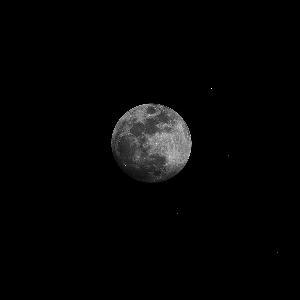

[[0 0 0 1 0 0 0]
 [0 1 1 1 1 1 0]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1]
 [0 1 1 1 1 1 0]
 [0 0 0 1 0 0 0]]
EROSION


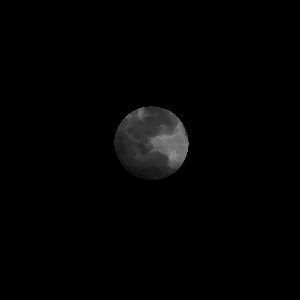

DILATION


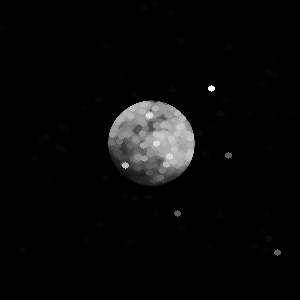

OPENING


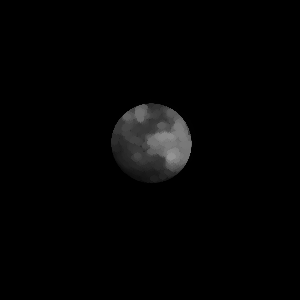

CLOSING


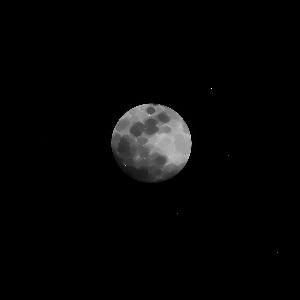

GRADIENT


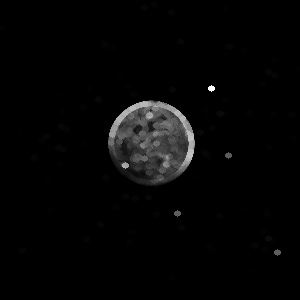

TOPHAT


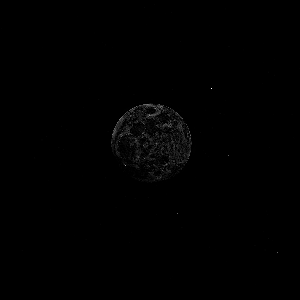

BLACKHAT


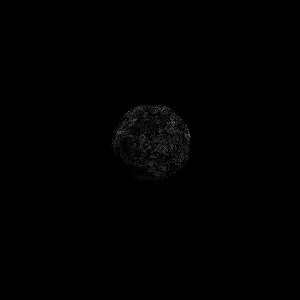

In [ ]:
img = cv2.imread('3.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(7,7))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

## **IMAGE 4**

ORIGINAL


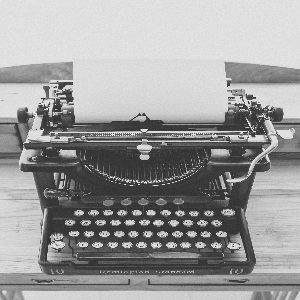

[[1 1]
 [1 1]]
EROSION


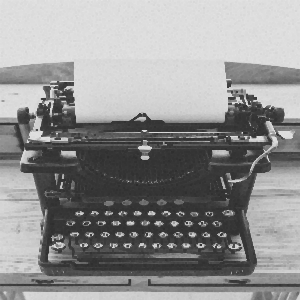

DILATION


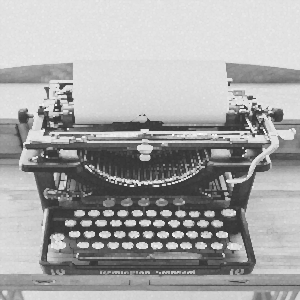

OPENING


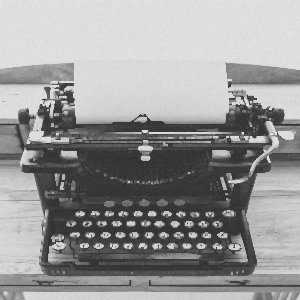

CLOSING


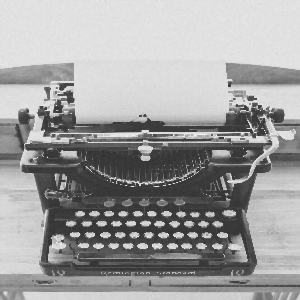

GRADIENT


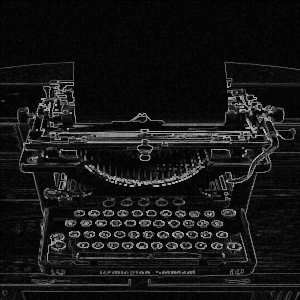

TOPHAT


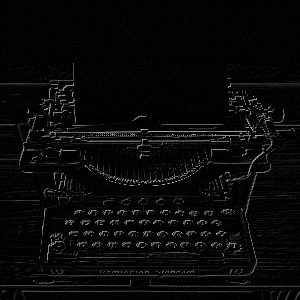

BLACKHAT


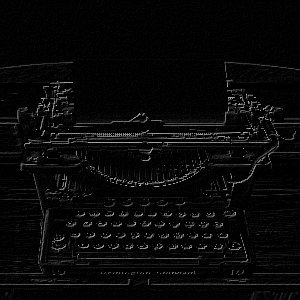

In [ ]:
img = cv2.imread('4.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(2,2))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


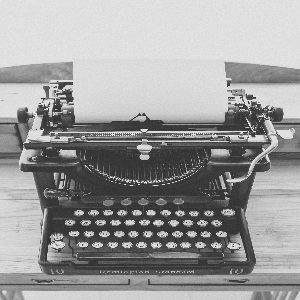

[[1 1 1]
 [1 1 1]
 [1 1 1]]
EROSION


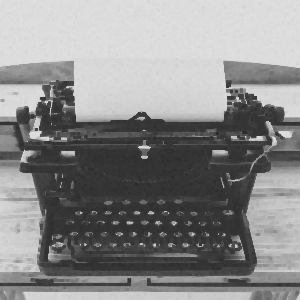

DILATION


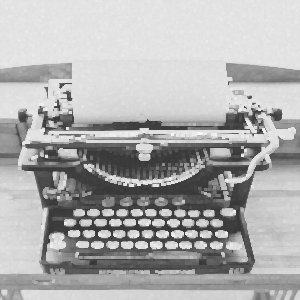

OPENING


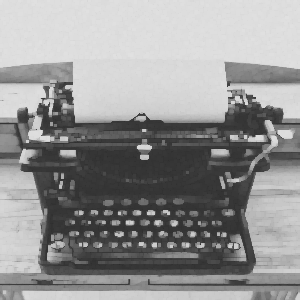

CLOSING


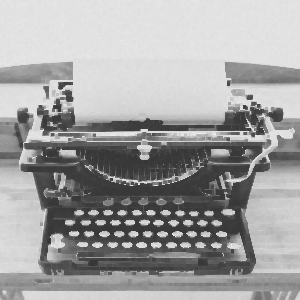

GRADIENT


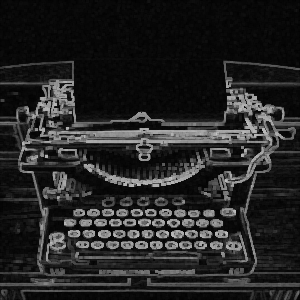

TOPHAT


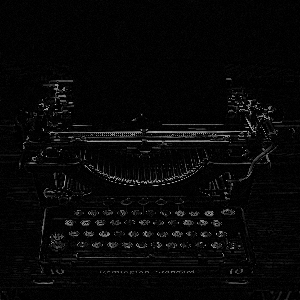

BLACKHAT


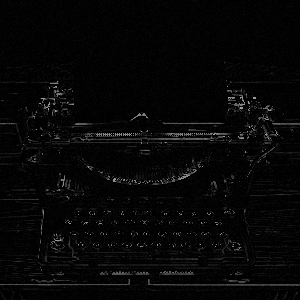

In [ ]:
img = cv2.imread('4.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(3,3))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


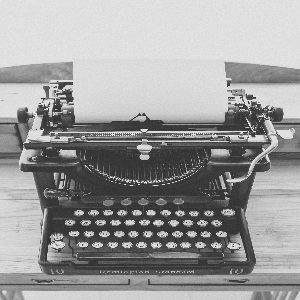

[[1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]]
EROSION


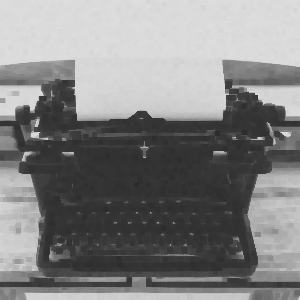

DILATION


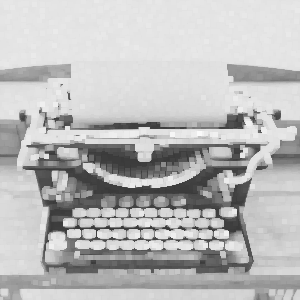

OPENING


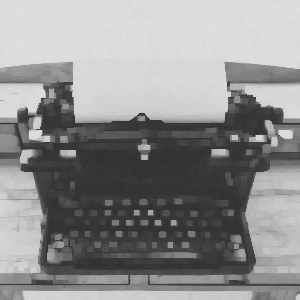

CLOSING


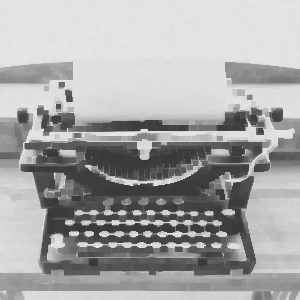

GRADIENT


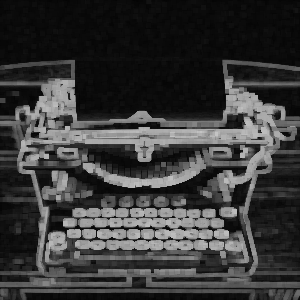

TOPHAT


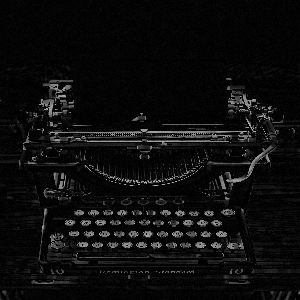

BLACKHAT


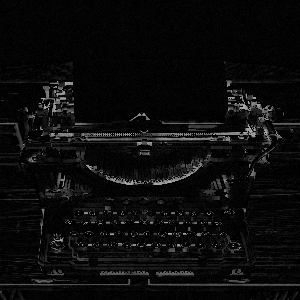

In [ ]:
img = cv2.imread('4.jpg',0)
img=cv2.resize(img,(300,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(5,5))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

## **IMAGE 5**

ORIGINAL


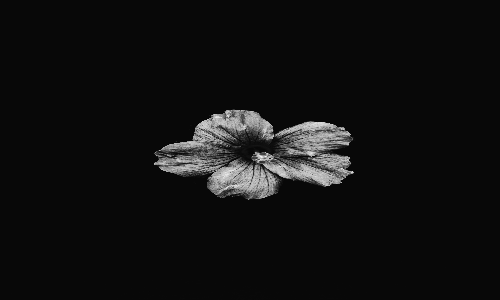

[[0 1]
 [1 1]]
EROSION


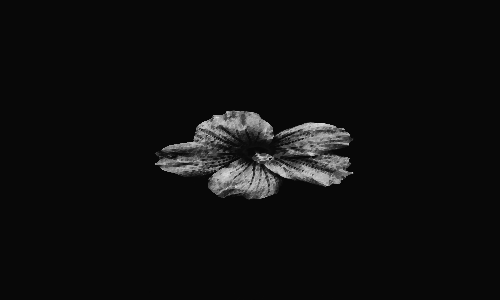

DILATION


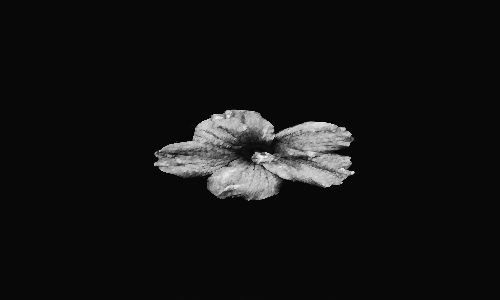

OPENING


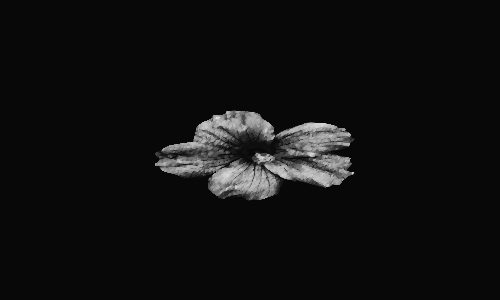

CLOSING


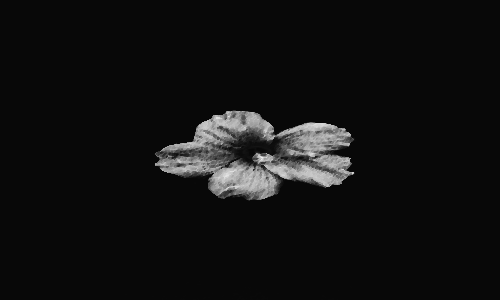

GRADIENT


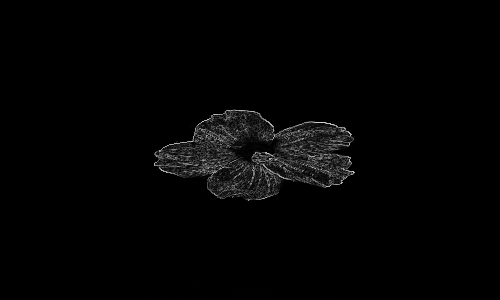

TOPHAT


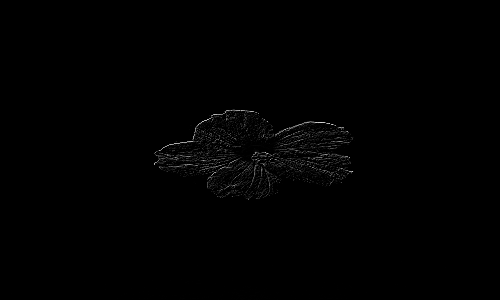

BLACKHAT


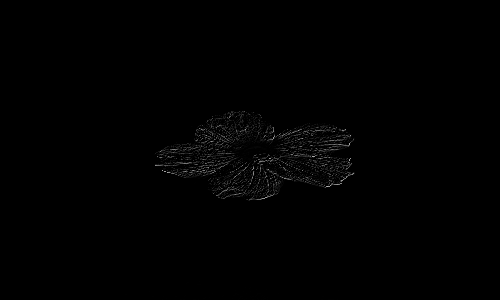

In [ ]:
img = cv2.imread('5.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(2,2))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


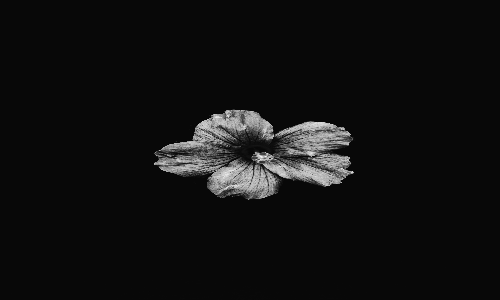

[[0 1 0]
 [1 1 1]
 [0 1 0]]
EROSION


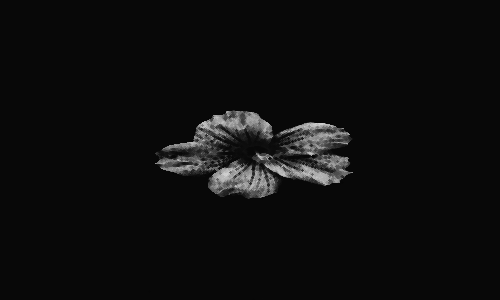

DILATION


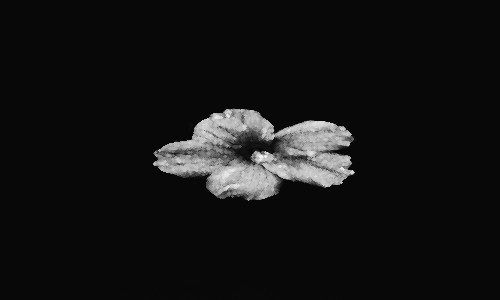

OPENING


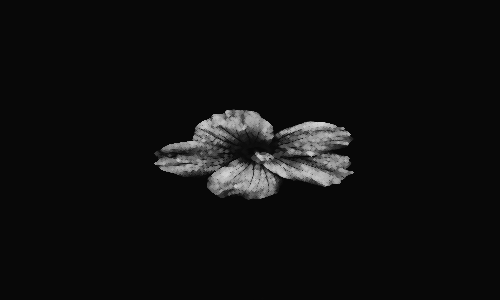

CLOSING


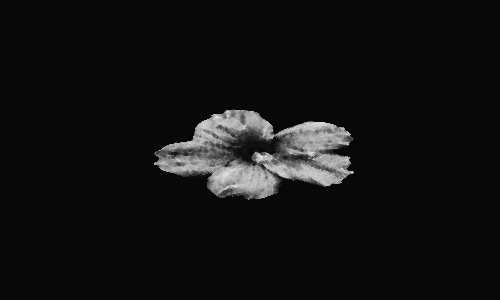

GRADIENT


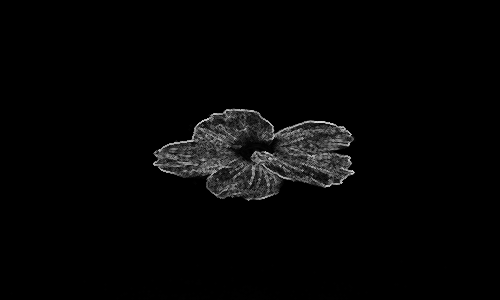

TOPHAT


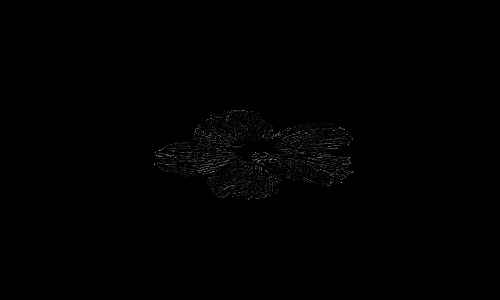

BLACKHAT


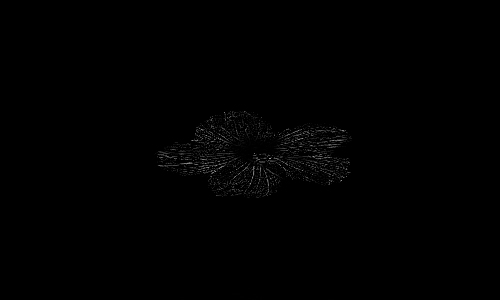

In [ ]:
img = cv2.imread('5.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(3,3))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

ORIGINAL


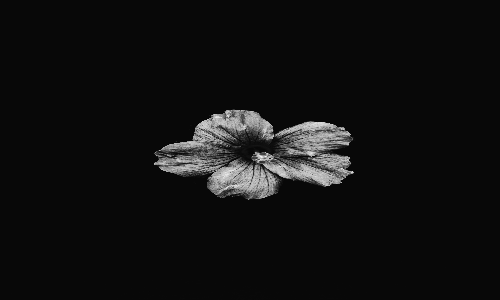

[[0 0 1 0 0]
 [0 0 1 0 0]
 [1 1 1 1 1]
 [0 0 1 0 0]
 [0 0 1 0 0]]
EROSION


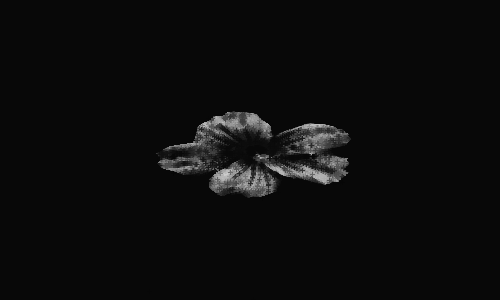

DILATION


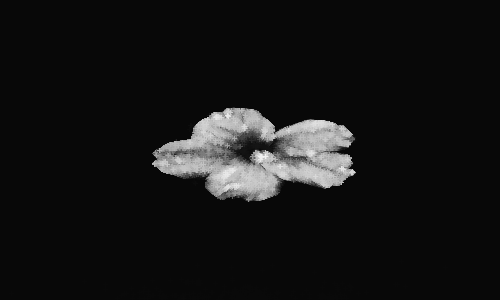

OPENING


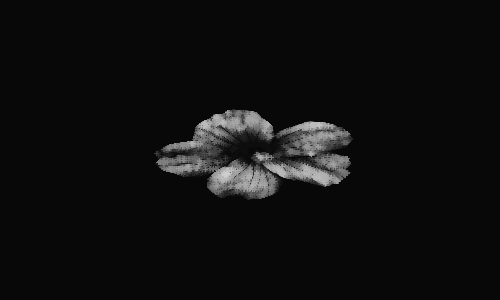

CLOSING


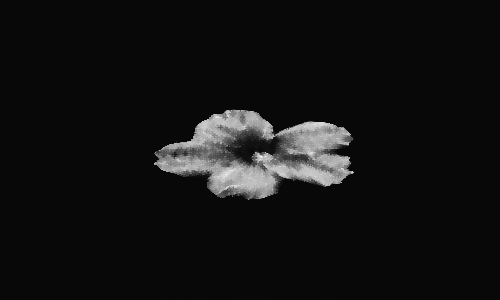

GRADIENT


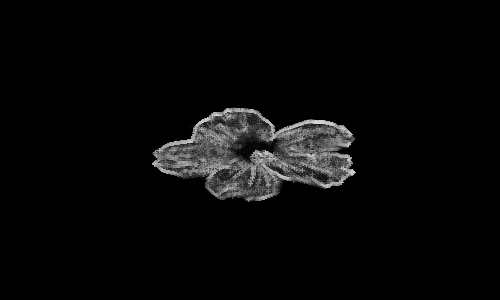

TOPHAT


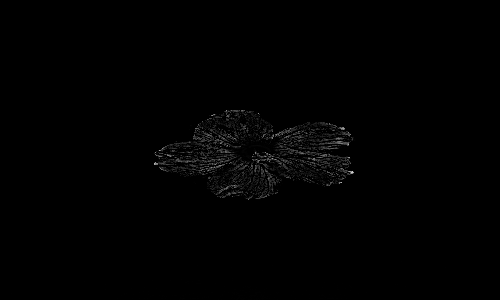

BLACKHAT


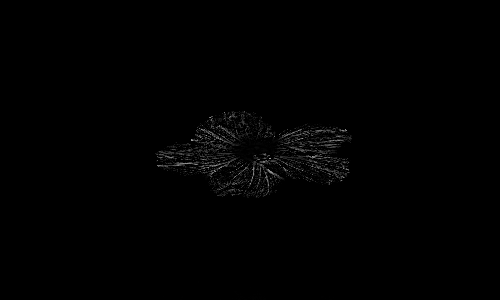

In [ ]:
img = cv2.imread('5.jpg',0)
img=cv2.resize(img,(500,300))
print('ORIGINAL')
cv2_imshow(img)

kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(5,5))
print(kernel)

erosion = cv2.erode(img,kernel,iterations = 1)
print('EROSION')
cv2_imshow(erosion)

dilation = cv2.dilate(img,kernel,iterations = 1)
print('DILATION')
cv2_imshow(dilation)

opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
print('OPENING')
cv2_imshow(opening)

closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print('CLOSING')
cv2_imshow(closing)

gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print('GRADIENT')
cv2_imshow(gradient)

tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
print('TOPHAT')
cv2_imshow(tophat)

blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print('BLACKHAT')
cv2_imshow(blackhat)

# **5. Stereo Vision**

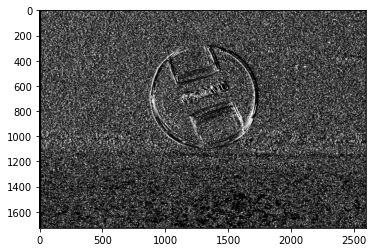

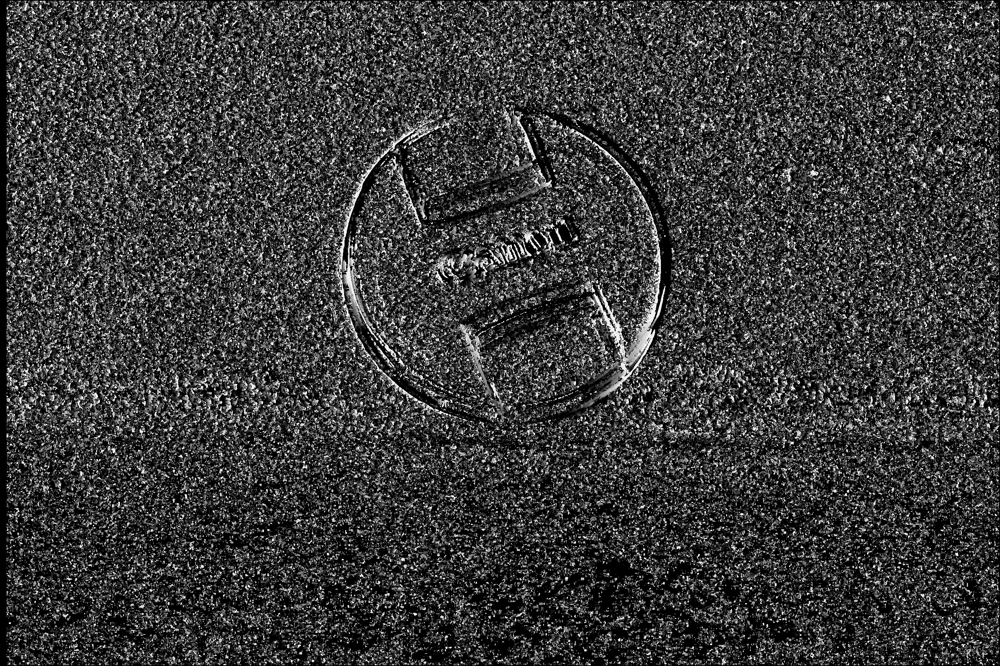

In [ ]:
import numpy as np
import cv2 as cvfrom matplotlib import pyplot as plt
imgL = cv.imread('l.JPG',0)
imgR = cv.imread('r.JPG',0)
stereo = cv.StereoBM_create(numDisparities=16, blockSize=5)
disparity = stereo.compute(imgL,imgR)
plt.imshow(disparity,'gray')
plt.show()
cv2_imshow(disparity)

In [ ]:
#depth = cv2.reprojectImageTo3D(disparity, Q)
#print(depth)

print(disparity)

D= 1*24/disparity # Depth = Baseline * focal length/ Disparity
#where 1 mm is baseline and 24 mm is focal length of my device camera :) 
D

[[-16 -16 -16 ... -16 -16 -16]
 [-16 -16 -16 ... -16 -16 -16]
 [-16 -16 -16 ...  73 -16 -16]
 ...
 [-16 -16 -16 ... -16 -16 -16]
 [-16 -16 -16 ... -16 -16 -16]
 [-16 -16 -16 ... -16 -16 -16]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in true_divide
  


array([[-1.5       , -1.5       , -1.5       , ..., -1.5       ,
        -1.5       , -1.5       ],
       [-1.5       , -1.5       , -1.5       , ..., -1.5       ,
        -1.5       , -1.5       ],
       [-1.5       , -1.5       , -1.5       , ...,  0.32876712,
        -1.5       , -1.5       ],
       ...,
       [-1.5       , -1.5       , -1.5       , ..., -1.5       ,
        -1.5       , -1.5       ],
       [-1.5       , -1.5       , -1.5       , ..., -1.5       ,
        -1.5       , -1.5       ],
       [-1.5       , -1.5       , -1.5       , ..., -1.5       ,
        -1.5       , -1.5       ]])

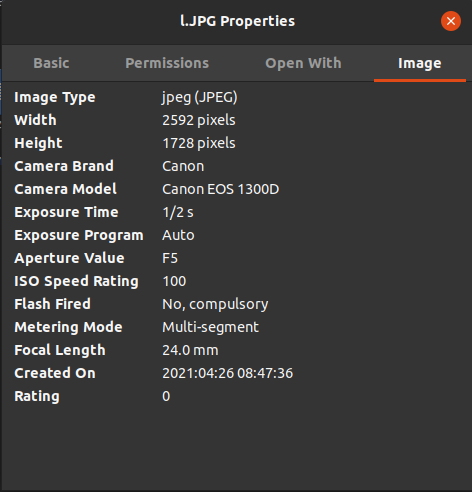

# **6. Hough Circle (using Inbuilt) - PART 1**

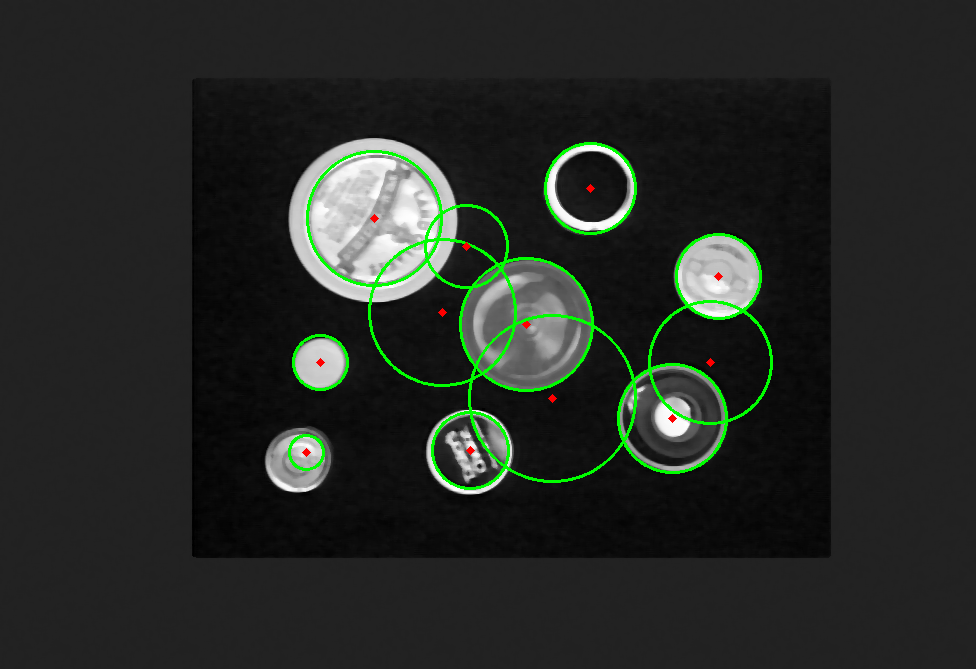

In [ ]:
img = cv2.imread('img1.png',0)
img = cv2.medianBlur(img,5)
cimg = cv2.cvtColor(img,cv2.COLOR_GRAY2BGR)
 
circles = cv2.HoughCircles(img,cv2.HOUGH_GRADIENT,1,60,param1=50,param2=30,minRadius=0,maxRadius=120)
# 60 is the minimum centroid distance
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),2)
    # draw the center of the circle
    cv2.circle(cimg,(i[0],i[1]),2,(0,0,255),3)
 
cv2_imshow(cimg)
cv2.waitKey(0)
cv2.destroyAllWindows()

# **6.i Hough Transform Scratch - PART 2 [Canny Experiment]**

---
Theory Reference : https://www.youtube.com/watch?v=Ltqt24SQQoI


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


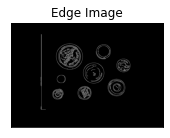

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
img = cv2.imread('img1.png',0)
edges = cv.Canny(img,100,200)
plt.subplot(121),plt.imshow(img,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(121),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])
plt.show()

# **6.ii Hough Transform using Canny Detection (Scratch)**

**Canny Edge Detector**

In [ ]:
from math import sqrt, atan2, pi

def canny_edge_detector(input_image):
    input_pixels = input_image.load()
    width = input_image.width
    height = input_image.height

    # Transform the image to grayscale
    grayscaled = compute_grayscale(input_pixels, width, height)

    # Blur it to remove noise
    blurred = compute_blur(grayscaled, width, height)

    # Compute the gradient
    gradient, direction = compute_gradient(blurred, width, height)

    # Non-maximum suppression
    filter_out_non_maximum(gradient, direction, width, height)

    # Filter out some edges
    keep = filter_strong_edges(gradient, width, height, 20, 25)

    return keep


def compute_grayscale(input_pixels, width, height):
    grayscale = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            pixel = input_pixels[x, y]
            grayscale[x, y] = (pixel[0] + pixel[1] + pixel[2]) / 3
    return grayscale


def compute_blur(input_pixels, width, height):
    # Keep coordinate inside image
    clip = lambda x, l, u: l if x < l else u if x > u else x

    # Gaussian kernel
    kernel = np.array([
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [6 / 256, 24 / 256, 36 / 256, 24 / 256, 6 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256]
    ])

    # Middle of the kernel
    offset = len(kernel) // 2

    # Compute the blurred image
    blurred = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            acc = 0
            for a in range(len(kernel)):
                for b in range(len(kernel)):
                    xn = clip(x + a - offset, 0, width - 1)
                    yn = clip(y + b - offset, 0, height - 1)
                    acc += input_pixels[xn, yn] * kernel[a, b]
            blurred[x, y] = int(acc)
    return blurred


def compute_gradient(input_pixels, width, height):
    gradient = np.zeros((width, height))
    direction = np.zeros((width, height))
    for x in range(width):
        for y in range(height):
            if 0 < x < width - 1 and 0 < y < height - 1:
                magx = input_pixels[x + 1, y] - input_pixels[x - 1, y]
                magy = input_pixels[x, y + 1] - input_pixels[x, y - 1]
                gradient[x, y] = sqrt(magx**2 + magy**2)
                direction[x, y] = atan2(magy, magx)
    return gradient, direction


def filter_out_non_maximum(gradient, direction, width, height):
    for x in range(1, width - 1):
        for y in range(1, height - 1):
            angle = direction[x, y] if direction[x, y] >= 0 else direction[x, y] + pi
            rangle = round(angle / (pi / 4))
            mag = gradient[x, y]
            if ((rangle == 0 or rangle == 4) and (gradient[x - 1, y] > mag or gradient[x + 1, y] > mag)
                    or (rangle == 1 and (gradient[x - 1, y - 1] > mag or gradient[x + 1, y + 1] > mag))
                    or (rangle == 2 and (gradient[x, y - 1] > mag or gradient[x, y + 1] > mag))
                    or (rangle == 3 and (gradient[x + 1, y - 1] > mag or gradient[x - 1, y + 1] > mag))):
                gradient[x, y] = 0


def filter_strong_edges(gradient, width, height, low, high):
    # Keep strong edges
    keep = set()
    for x in range(width):
        for y in range(height):
            if gradient[x, y] > high:
                keep.add((x, y))

    # Keep weak edges next to a pixel to keep
    lastiter = keep
    while lastiter:
        newkeep = set()
        for x, y in lastiter:
            for a, b in ((-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)):
                if gradient[x + a, y + b] > low and (x+a, y+b) not in keep:
                    newkeep.add((x+a, y+b))
        keep.update(newkeep)
        lastiter = newkeep

    return list(keep)


if __name__ == "__main__":
    from PIL import Image, ImageDraw
    input_image = Image.open("img1.png")
    output_image = Image.new("RGB", input_image.size)
    draw = ImageDraw.Draw(output_image)
    for x, y in canny_edge_detector(input_image):
        draw.point((x, y), (255, 255, 255))
    output_image.save("canny.png")
    

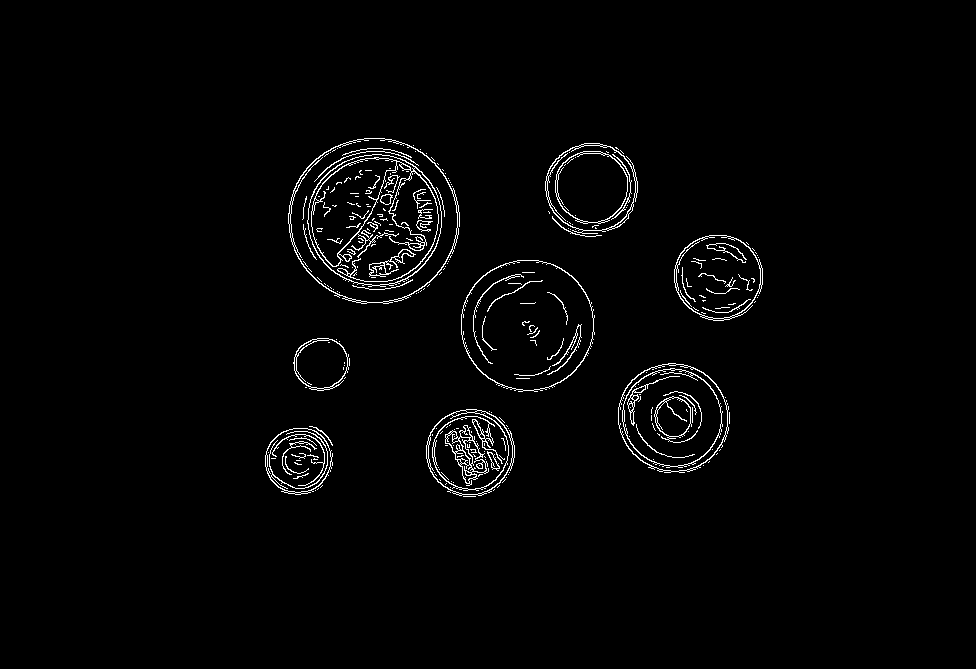

In [ ]:
output_image

**Hough Circle**
Theory Reference : https://www.youtube.com/watch?v=QDVObJbFaKQ

In [ ]:
from PIL import Image, ImageDraw
from math import sqrt, pi, cos, sin
from collections import defaultdict
from math import sqrt, atan2, pi

def canny_edge_detector(input_image):
    input_pixels = input_image.load()
    width = input_image.width
    height = input_image.height

    # Transform the image to grayscale
    grayscaled = compute_grayscale(input_pixels, width, height)

    # Blur it to remove noise
    blurred = compute_blur(grayscaled, width, height)

    # Compute the gradient
    gradient, direction = compute_gradient(blurred, width, height)

    # Non-maximum suppression
    filter_out_non_maximum(gradient, direction, width, height)

    # Filter out some edges
    keep = filter_strong_edges(gradient, width, height, 20, 25)

    return keep


def compute_grayscale(input_pixels, width, height):
    grayscale = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            pixel = input_pixels[x, y]
            grayscale[x, y] = (pixel[0] + pixel[1] + pixel[2]) / 3
    return grayscale


def compute_blur(input_pixels, width, height):
    # Keep coordinate inside image
    clip = lambda x, l, u: l if x < l else u if x > u else x

    # Gaussian kernel
    kernel = np.array([
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [6 / 256, 24 / 256, 36 / 256, 24 / 256, 6 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256] ])

    # Middle of the kernel
    offset = len(kernel) // 2

    # Compute the blurred image
    blurred = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            acc = 0
            for a in range(len(kernel)):
                for b in range(len(kernel)):
                    xn = clip(x + a - offset, 0, width - 1)
                    yn = clip(y + b - offset, 0, height - 1)
                    acc += input_pixels[xn, yn] * kernel[a, b]
            blurred[x, y] = int(acc)
    return blurred


def compute_gradient(input_pixels, width, height):
    gradient = np.zeros((width, height))
    direction = np.zeros((width, height))
    for x in range(width):
        for y in range(height):
            if 0 < x < width - 1 and 0 < y < height - 1:
                magx = input_pixels[x + 1, y] - input_pixels[x - 1, y]
                magy = input_pixels[x, y + 1] - input_pixels[x, y - 1]
                gradient[x, y] = sqrt(magx**2 + magy**2)
                direction[x, y] = atan2(magy, magx)
    return gradient, direction


def filter_out_non_maximum(gradient, direction, width, height):
    for x in range(1, width - 1):
        for y in range(1, height - 1):
            angle = direction[x, y] if direction[x, y] >= 0 else direction[x, y] + pi
            rangle = round(angle / (pi / 4))
            mag = gradient[x, y]
            if ((rangle == 0 or rangle == 4) and (gradient[x - 1, y] > mag or gradient[x + 1, y] > mag)
                    or (rangle == 1 and (gradient[x - 1, y - 1] > mag or gradient[x + 1, y + 1] > mag))
                    or (rangle == 2 and (gradient[x, y - 1] > mag or gradient[x, y + 1] > mag))
                    or (rangle == 3 and (gradient[x + 1, y - 1] > mag or gradient[x - 1, y + 1] > mag))):
                gradient[x, y] = 0


def filter_strong_edges(gradient, width, height, low, high):
    # Keep strong edges
    keep = set()
    for x in range(width):
        for y in range(height):
            if gradient[x, y] > high:
                keep.add((x, y))

    # Keep weak edges next to a pixel to keep
    lastiter = keep
    while lastiter:
        newkeep = set()
        for x, y in lastiter:
            for a, b in ((-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)):
                if gradient[x + a, y + b] > low and (x+a, y+b) not in keep:
                    newkeep.add((x+a, y+b))
        keep.update(newkeep)
        lastiter = newkeep

    return list(keep)

#########################################################################################################################
##################################HOUGH CIRCLE USING ABOVE CANNY DETECTOR OUTPUT IMAGE###################################
#########################################################################################################################


from PIL import Image, ImageDraw
input_image = Image.open("img1.png")
output_image = Image.new("RGB", input_image.size)
draw = ImageDraw.Draw(output_image)
for x, y in canny_edge_detector(input_image):
    draw.point((x, y), (255, 255, 255))
output_image.save("canny.png")

# Load image:
input_image = Image.open("img1.png")

# Output image:
output_image = Image.new("RGB", input_image.size)

output_image.paste(input_image)

draw_result = ImageDraw.Draw(output_image)

# Find circles
rmin = 30
rmax = 120
steps = 100
threshold = 0.4

points = []
for r in range(rmin, rmax + 1):
    for t in range(steps):
        points.append((r, int(r * cos(2 * pi * t / steps)), int(r * sin(2 * pi * t / steps))))

acc = defaultdict(int)
print(acc)
for x, y in canny_edge_detector(input_image):
    for r, dx, dy in points:
        a = x - dx
        b = y - dy
        acc[(a, b, r)] += 1

circles = []
for k, v in sorted(acc.items(), key = lambda i : -i[1]):
    x, y, r = k
    if v / steps >= threshold and all((x - xc) ** 2 + (y - yc) ** 2 - rc ** 2 > 0 for xc, yc, rc in circles):
        print(v / steps, x, y, r)
        circles.append((x, y, r))

for x, y, r in circles:
    draw_result.ellipse((x-r, y-r, x+r, y+r), outline=(255,0,0,0))

# Save output image
output_image.save("result.png")

defaultdict(<class 'int'>, {})
0.69 592 186 36
0.68 718 276 43
0.63 469 451 44
0.62 297 461 33
0.62 376 219 66
0.62 672 417 49
0.61 527 324 67


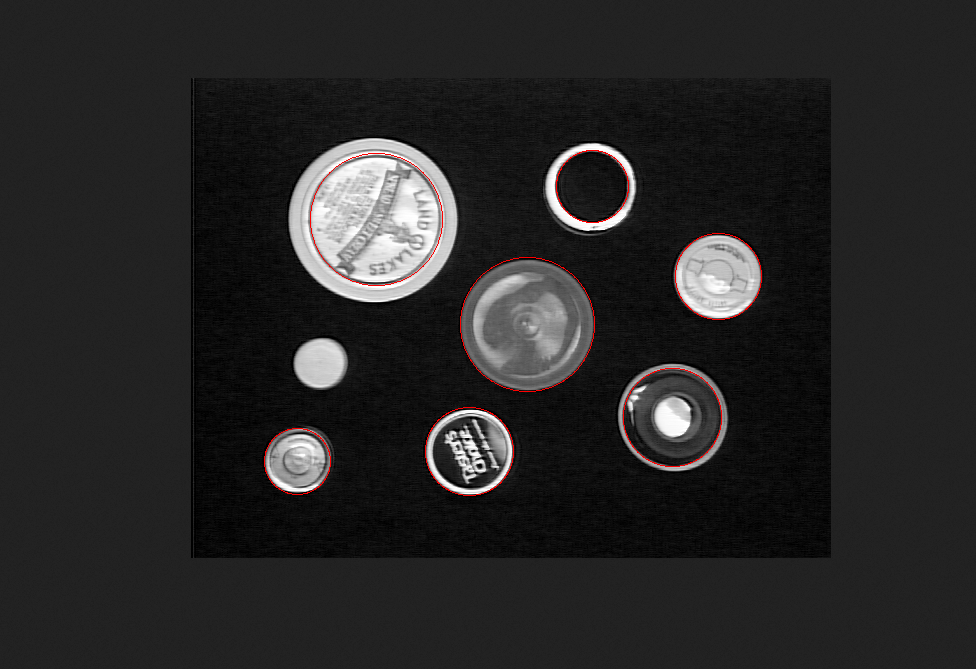

In [ ]:
output_image

In [ ]:
from PIL import Image, ImageDraw
from math import sqrt, pi, cos, sin
from collections import defaultdict
from math import sqrt, atan2, pi

def canny_edge_detector(input_image):
    input_pixels = input_image.load()
    width = input_image.width
    height = input_image.height

    # Transform the image to grayscale
    grayscaled = compute_grayscale(input_pixels, width, height)

    # Blur it to remove noise
    blurred = compute_blur(grayscaled, width, height)

    # Compute the gradient
    gradient, direction = compute_gradient(blurred, width, height)

    # Non-maximum suppression
    filter_out_non_maximum(gradient, direction, width, height)

    # Filter out some edges
    keep = filter_strong_edges(gradient, width, height, 20, 25)

    return keep


def compute_grayscale(input_pixels, width, height):
    grayscale = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            pixel = input_pixels[x, y]
            grayscale[x, y] = (pixel[0] + pixel[1] + pixel[2]) / 3
    return grayscale


def compute_blur(input_pixels, width, height):
    # Keep coordinate inside image
    clip = lambda x, l, u: l if x < l else u if x > u else x

    # Gaussian kernel
    kernel = np.array([
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [6 / 256, 24 / 256, 36 / 256, 24 / 256, 6 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256] ])

    # Middle of the kernel
    offset = len(kernel) // 2

    # Compute the blurred image
    blurred = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            acc = 0
            for a in range(len(kernel)):
                for b in range(len(kernel)):
                    xn = clip(x + a - offset, 0, width - 1)
                    yn = clip(y + b - offset, 0, height - 1)
                    acc += input_pixels[xn, yn] * kernel[a, b]
            blurred[x, y] = int(acc)
    return blurred


def compute_gradient(input_pixels, width, height):
    gradient = np.zeros((width, height))
    direction = np.zeros((width, height))
    for x in range(width):
        for y in range(height):
            if 0 < x < width - 1 and 0 < y < height - 1:
                magx = input_pixels[x + 1, y] - input_pixels[x - 1, y]
                magy = input_pixels[x, y + 1] - input_pixels[x, y - 1]
                gradient[x, y] = sqrt(magx**2 + magy**2)
                direction[x, y] = atan2(magy, magx)
    return gradient, direction


def filter_out_non_maximum(gradient, direction, width, height):
    for x in range(1, width - 1):
        for y in range(1, height - 1):
            angle = direction[x, y] if direction[x, y] >= 0 else direction[x, y] + pi
            rangle = round(angle / (pi / 4))
            mag = gradient[x, y]
            if ((rangle == 0 or rangle == 4) and (gradient[x - 1, y] > mag or gradient[x + 1, y] > mag)
                    or (rangle == 1 and (gradient[x - 1, y - 1] > mag or gradient[x + 1, y + 1] > mag))
                    or (rangle == 2 and (gradient[x, y - 1] > mag or gradient[x, y + 1] > mag))
                    or (rangle == 3 and (gradient[x + 1, y - 1] > mag or gradient[x - 1, y + 1] > mag))):
                gradient[x, y] = 0


def filter_strong_edges(gradient, width, height, low, high):
    # Keep strong edges
    keep = set()
    for x in range(width):
        for y in range(height):
            if gradient[x, y] > high:
                keep.add((x, y))

    # Keep weak edges next to a pixel to keep
    lastiter = keep
    while lastiter:
        newkeep = set()
        for x, y in lastiter:
            for a, b in ((-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)):
                if gradient[x + a, y + b] > low and (x+a, y+b) not in keep:
                    newkeep.add((x+a, y+b))
        keep.update(newkeep)
        lastiter = newkeep

    return list(keep)

#########################################################################################################################
##################################HOUGH CIRCLE USING ABOVE CANNY DETECTOR OUTPUT IMAGE###################################
#########################################################################################################################


from PIL import Image, ImageDraw
input_image = Image.open("img2.png")
output_image = Image.new("RGB", input_image.size)
draw = ImageDraw.Draw(output_image)
for x, y in canny_edge_detector(input_image):
    draw.point((x, y), (255, 255, 255))
output_image.save("canny.png")

# Load image:
input_image = Image.open("img2.png")

# Output image:
output_image = Image.new("RGB", input_image.size)

output_image.paste(input_image)

draw_result = ImageDraw.Draw(output_image)

# Find circles
rmin = 30
rmax = 120
steps = 100
threshold = 0.4

points = []
for r in range(rmin, rmax + 1):
    for t in range(steps):
        points.append((r, int(r * cos(2 * pi * t / steps)), int(r * sin(2 * pi * t / steps))))

acc = defaultdict(int)
print(acc)
for x, y in canny_edge_detector(input_image):
    for r, dx, dy in points:
        a = x - dx
        b = y - dy
        acc[(a, b, r)] += 1

circles = []
for k, v in sorted(acc.items(), key = lambda i : -i[1]):
    x, y, r = k
    if v / steps >= threshold and all((x - xc) ** 2 + (y - yc) ** 2 - rc ** 2 > 0 for xc, yc, rc in circles):
        print(v / steps, x, y, r)
        circles.append((x, y, r))

for x, y, r in circles:
    draw_result.ellipse((x-r, y-r, x+r, y+r), outline=(255,0,0,0))

# Save output image
output_image.save("result.png")

defaultdict(<class 'int'>, {})
0.63 567 190 68
0.59 172 443 39
0.58 319 360 33
0.57 432 311 43
0.53 128 283 45
0.52 376 151 53
0.44 556 415 57
0.43 233 214 31
0.42 285 427 30
0.42 301 168 46
0.41 186 212 30
0.41 242 410 37
0.41 440 220 41


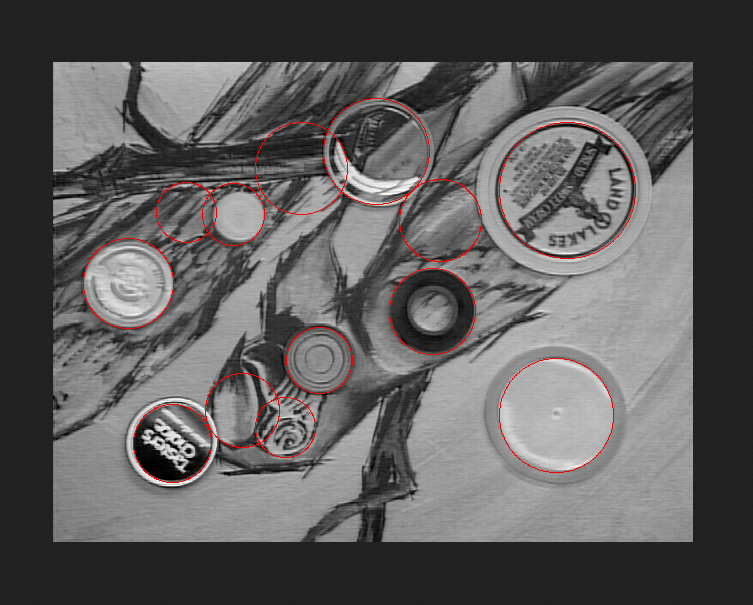

In [ ]:
output_image

In [ ]:
from PIL import Image, ImageDraw
from math import sqrt, pi, cos, sin
from collections import defaultdict
from math import sqrt, atan2, pi

def canny_edge_detector(input_image):
    input_pixels = input_image.load()
    width = input_image.width
    height = input_image.height

    # Transform the image to grayscale
    grayscaled = compute_grayscale(input_pixels, width, height)

    # Blur it to remove noise
    blurred = compute_blur(grayscaled, width, height)

    # Compute the gradient
    gradient, direction = compute_gradient(blurred, width, height)

    # Non-maximum suppression
    filter_out_non_maximum(gradient, direction, width, height)

    # Filter out some edges
    keep = filter_strong_edges(gradient, width, height, 20, 25)

    return keep


def compute_grayscale(input_pixels, width, height):
    grayscale = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            pixel = input_pixels[x, y]
            grayscale[x, y] = (pixel[0] + pixel[1] + pixel[2]) / 3
    return grayscale


def compute_blur(input_pixels, width, height):
    # Keep coordinate inside image
    clip = lambda x, l, u: l if x < l else u if x > u else x

    # Gaussian kernel
    kernel = np.array([
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [6 / 256, 24 / 256, 36 / 256, 24 / 256, 6 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256] ])

    # Middle of the kernel
    offset = len(kernel) // 2

    # Compute the blurred image
    blurred = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            acc = 0
            for a in range(len(kernel)):
                for b in range(len(kernel)):
                    xn = clip(x + a - offset, 0, width - 1)
                    yn = clip(y + b - offset, 0, height - 1)
                    acc += input_pixels[xn, yn] * kernel[a, b]
            blurred[x, y] = int(acc)
    return blurred


def compute_gradient(input_pixels, width, height):
    gradient = np.zeros((width, height))
    direction = np.zeros((width, height))
    for x in range(width):
        for y in range(height):
            if 0 < x < width - 1 and 0 < y < height - 1:
                magx = input_pixels[x + 1, y] - input_pixels[x - 1, y]
                magy = input_pixels[x, y + 1] - input_pixels[x, y - 1]
                gradient[x, y] = sqrt(magx**2 + magy**2)
                direction[x, y] = atan2(magy, magx)
    return gradient, direction


def filter_out_non_maximum(gradient, direction, width, height):
    for x in range(1, width - 1):
        for y in range(1, height - 1):
            angle = direction[x, y] if direction[x, y] >= 0 else direction[x, y] + pi
            rangle = round(angle / (pi / 4))
            mag = gradient[x, y]
            if ((rangle == 0 or rangle == 4) and (gradient[x - 1, y] > mag or gradient[x + 1, y] > mag)
                    or (rangle == 1 and (gradient[x - 1, y - 1] > mag or gradient[x + 1, y + 1] > mag))
                    or (rangle == 2 and (gradient[x, y - 1] > mag or gradient[x, y + 1] > mag))
                    or (rangle == 3 and (gradient[x + 1, y - 1] > mag or gradient[x - 1, y + 1] > mag))):
                gradient[x, y] = 0


def filter_strong_edges(gradient, width, height, low, high):
    # Keep strong edges
    keep = set()
    for x in range(width):
        for y in range(height):
            if gradient[x, y] > high:
                keep.add((x, y))

    # Keep weak edges next to a pixel to keep
    lastiter = keep
    while lastiter:
        newkeep = set()
        for x, y in lastiter:
            for a, b in ((-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)):
                if gradient[x + a, y + b] > low and (x+a, y+b) not in keep:
                    newkeep.add((x+a, y+b))
        keep.update(newkeep)
        lastiter = newkeep

    return list(keep)

#########################################################################################################################
##################################HOUGH CIRCLE USING ABOVE CANNY DETECTOR OUTPUT IMAGE###################################
#########################################################################################################################


from PIL import Image, ImageDraw
input_image = Image.open("img3.png")
output_image = Image.new("RGB", input_image.size)
draw = ImageDraw.Draw(output_image)
for x, y in canny_edge_detector(input_image):
    draw.point((x, y), (255, 255, 255))
output_image.save("canny.png")

# Load image:
input_image = Image.open("img3.png")

# Output image:
output_image = Image.new("RGB", input_image.size)

output_image.paste(input_image)

draw_result = ImageDraw.Draw(output_image)

# Find circles
rmin = 30
rmax = 150
steps = 100
threshold = 0.4

points = []
for r in range(rmin, rmax + 1):
    for t in range(steps):
        points.append((r, int(r * cos(2 * pi * t / steps)), int(r * sin(2 * pi * t / steps))))

acc = defaultdict(int)
print(acc)
for x, y in canny_edge_detector(input_image):
    for r, dx, dy in points:
        a = x - dx
        b = y - dy
        acc[(a, b, r)] += 1

circles = []
for k, v in sorted(acc.items(), key = lambda i : -i[1]):
    x, y, r = k
    if v / steps >= threshold and all((x - xc) ** 2 + (y - yc) ** 2 - rc ** 2 > 0 for xc, yc, rc in circles):
        print(v / steps, x, y, r)
        circles.append((x, y, r))

for x, y, r in circles:
    draw_result.ellipse((x-r, y-r, x+r, y+r), outline=(255,0,0,0))

# Save output image
output_image.save("result.png")

defaultdict(<class 'int'>, {})
0.58 270 262 51
0.57 297 339 55
0.55 370 351 60
0.55 497 361 81
0.54 292 193 33
0.54 574 275 34
0.48 460 212 87


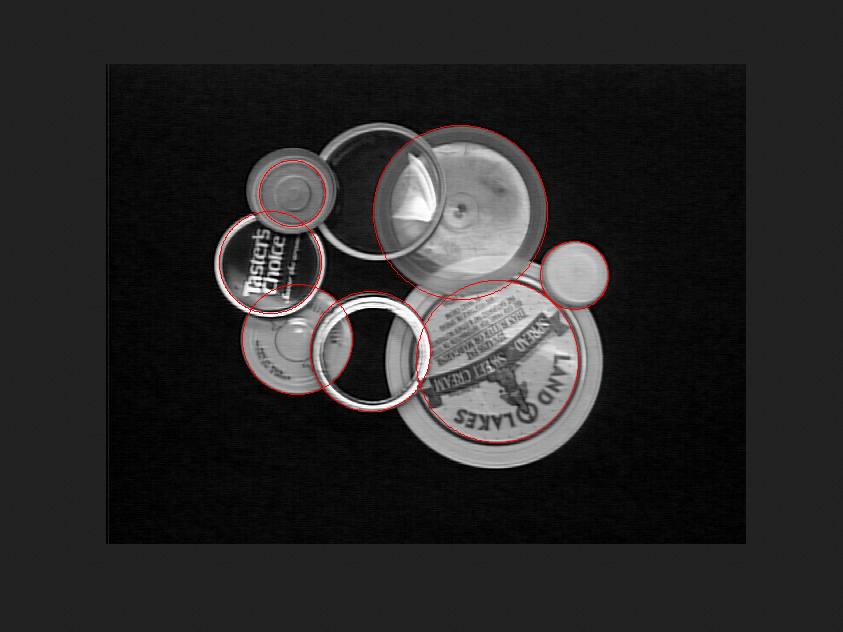

In [ ]:
output_image